# Project - Prediction of Smokers

Healthcare industry has been revolutionized with the induction of Machine Learning and Data Science . Now soo many diseases can be predicted with the help of ML .

Data Analysis also gives meaningful insights about soo many chronic health problems like Bp , Sugar , Triglycerides .

Predict smokers and non-smokers can be helpful for mediclaim and health insurance companies and medicine industry . Also we can see how smoking affects general health and how it is impacting chronic health issues .

In this project i have done in depth EDA and uses 7 different ML models to predict whether a person is smoker or not . I have achieved an accuracy score of 77.98% in this project . this project also gives us certain underlying aspects like smokers has higher BMI than normal person and they also have lower good cholesterol etc .

This dataset has 24 columns and out of which 'smoking' is our target variable and all the other 23 features is our indipendent variables . in 'smoking' column we have 2 values 0 and 1 .

0 means non-smoker and 1 means smoker .

I hope this project had done some justice and please look below for different Data analysis and ML approach .

In [ ]:
import numpy as np  ## Importing numpy library for data analysis .
import pandas as pd  ## Importing Pandas library for data analysis .
import matplotlib.pyplot as plt  ## Importing matplotlib library for data visualization .
import seaborn as sns  ## Importing seaborn library for data visualization .
import plotly.express as px ## Importing plotly express for advance data visualization .

In [ ]:
Smoker_raw=pd.read_csv("/content/Smoker_Prediction.csv")
smoker=Smoker_raw.copy()  ## Create a copy of our dataset for further analysis .
smoker.head()  ## head function will show us the top 5 rows .

,id,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,40,75,16.5,1,1.0,22,25,27,0,1
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,57,126,16.2,1,1.1,27,23,37,1,0
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,45,93,17.4,1,0.8,27,31,53,0,1
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,38,102,15.9,1,1.0,20,27,30,1,0
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,44,93,15.4,1,0.8,19,13,17,0,1


In [ ]:
smoker.info() ## info function will show total no of non null rows , datatypes of all the columns .

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159256 entries, 0 to 159255
Data columns (total 24 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   159256 non-null  int64  
 1   age                  159256 non-null  int64  
 2   height(cm)           159256 non-null  int64  
 3   weight(kg)           159256 non-null  int64  
 4   waist(cm)            159256 non-null  float64
 5   eyesight(left)       159256 non-null  float64
 6   eyesight(right)      159256 non-null  float64
 7   hearing(left)        159256 non-null  int64  
 8   hearing(right)       159256 non-null  int64  
 9   systolic             159256 non-null  int64  
 10  relaxation           159256 non-null  int64  
 11  fasting blood sugar  159256 non-null  int64  
 12  Cholesterol          159256 non-null  int64  
 13  triglyceride         159256 non-null  int64  
 14  HDL                  159256 non-null  int64  
 15  LDL              

In [ ]:
smoker.isnull().sum() ## isnull().sum() will show us the total no of null values in each column .

id                     0
age                    0
height(cm)             0
weight(kg)             0
waist(cm)              0
eyesight(left)         0
eyesight(right)        0
hearing(left)          0
hearing(right)         0
systolic               0
relaxation             0
fasting blood sugar    0
Cholesterol            0
triglyceride           0
HDL                    0
LDL                    0
hemoglobin             0
Urine protein          0
serum creatinine       0
AST                    0
ALT                    0
Gtp                    0
dental caries          0
smoking                0
dtype: int64

In [ ]:
smoker.columns ## columns function will show the name of all columns .

Index(['id', 'age', 'height(cm)', 'weight(kg)', 'waist(cm)', 'eyesight(left)',
       'eyesight(right)', 'hearing(left)', 'hearing(right)', 'systolic',
       'relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride',
       'HDL', 'LDL', 'hemoglobin', 'Urine protein', 'serum creatinine', 'AST',
       'ALT', 'Gtp', 'dental caries', 'smoking'],
      dtype='object')

Renaming some columns to make it more robust and easy to understand .

In [ ]:
smoker=smoker.rename(columns={'age':'Age','height(cm)':'Height','weight(kg)':'Weight','waist(cm)':'Waist','eyesight(left)':'Eyesight_l',
                              'eyesight(right)':'Eyesight_r','hearing(left)':'Hearing_l','hearing(right)':'Hearing_r','systolic':'Systolic_BP',
                              'relaxation':'Relaxation','fasting blood sugar':'Sugar_fasting','triglyceride':'Triglyceride','Cholesterol':'Total_cholesterol',
                              'hemoglobin':'Hemoglobin','Urine protein':'Urine_protein','serum creatinine':'Creatinine','Gtp':'GTP',
                              'dental caries':'Dental_caries','smoking':'Smoker'})

In [ ]:
smoker.head() ## head function will show us the top 5 rows .

,id,Age,Height,Weight,Waist,Eyesight_l,Eyesight_r,Hearing_l,Hearing_r,Systolic_BP,...,HDL,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,Dental_caries,Smoker
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,40,75,16.5,1,1.0,22,25,27,0,1
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,57,126,16.2,1,1.1,27,23,37,1,0
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,45,93,17.4,1,0.8,27,31,53,0,1
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,38,102,15.9,1,1.0,20,27,30,1,0
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,44,93,15.4,1,0.8,19,13,17,0,1


In [ ]:
smoker.describe().T ## describe function will show min , max , mean , standard deviation , q1 , q2 or median and q3 .

,count,mean,std,min,25%,50%,75%,max
id,159256.0,79627.500000,45973.391572,0.0,39813.75,79627.5,119441.25,159255.0
Age,159256.0,44.306626,11.842286,20.0,40.00,40.0,55.00,85.0
Height,159256.0,165.266929,8.818970,135.0,160.00,165.0,170.00,190.0
Weight,159256.0,67.143662,12.586198,30.0,60.00,65.0,75.00,130.0
Waist,159256.0,83.001990,8.957937,51.0,77.00,83.0,89.00,127.0
Eyesight_l,159256.0,1.005798,0.402113,0.1,0.80,1.0,1.20,9.9
Eyesight_r,159256.0,1.000989,0.392299,0.1,0.80,1.0,1.20,9.9
Hearing_l,159256.0,1.023974,0.152969,1.0,1.00,1.0,1.00,2.0
Hearing_r,159256.0,1.023421,0.151238,1.0,1.00,1.0,1.00,2.0
Systolic_BP,159256.0,122.503648,12.729315,77.0,114.00,121.0,130.00,213.0


In [ ]:
## Creating a new column named BMI with existing Weight and Height column .
smoker['BMI']=smoker['Weight']/((smoker['Height']/100)*2)

In [ ]:
smoker.head() ## head function will show us the top 5 rows .

,id,Age,Height,Weight,Waist,Eyesight_l,Eyesight_r,Hearing_l,Hearing_r,Systolic_BP,...,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,Dental_caries,Smoker,BMI
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,75,16.5,1,1.0,22,25,27,0,1,18.181818
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,126,16.2,1,1.1,27,23,37,1,0,19.696970
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,93,17.4,1,0.8,27,31,53,0,1,22.058824
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,102,15.9,1,1.0,20,27,30,1,0,26.388889
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,93,15.4,1,0.8,19,13,17,0,1,18.181818


In [ ]:
num_smoker=smoker.drop(['id','Dental_caries','Smoker'],axis=1) ## Dropping some unnecessary columns with drop function .
num_smoker.head() ## head function will show us the top 5 rows .

,Age,Height,Weight,Waist,Eyesight_l,Eyesight_r,Hearing_l,Hearing_r,Systolic_BP,Relaxation,...,Triglyceride,HDL,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,BMI
0,55,165,60,81.0,0.5,0.6,1,1,135,87,...,300,40,75,16.5,1,1.0,22,25,27,18.181818
1,70,165,65,89.0,0.6,0.7,2,2,146,83,...,55,57,126,16.2,1,1.1,27,23,37,19.696970
2,20,170,75,81.0,0.4,0.5,1,1,118,75,...,197,45,93,17.4,1,0.8,27,31,53,22.058824
3,35,180,95,105.0,1.5,1.2,1,1,131,88,...,203,38,102,15.9,1,1.0,20,27,30,26.388889
4,30,165,60,80.5,1.5,1.0,1,1,121,76,...,87,44,93,15.4,1,0.8,19,13,17,18.181818


Creating a for loop with histogram for all the numeric columns to see their distribution and also we can see each columns mean , median , iqr , min and max values .

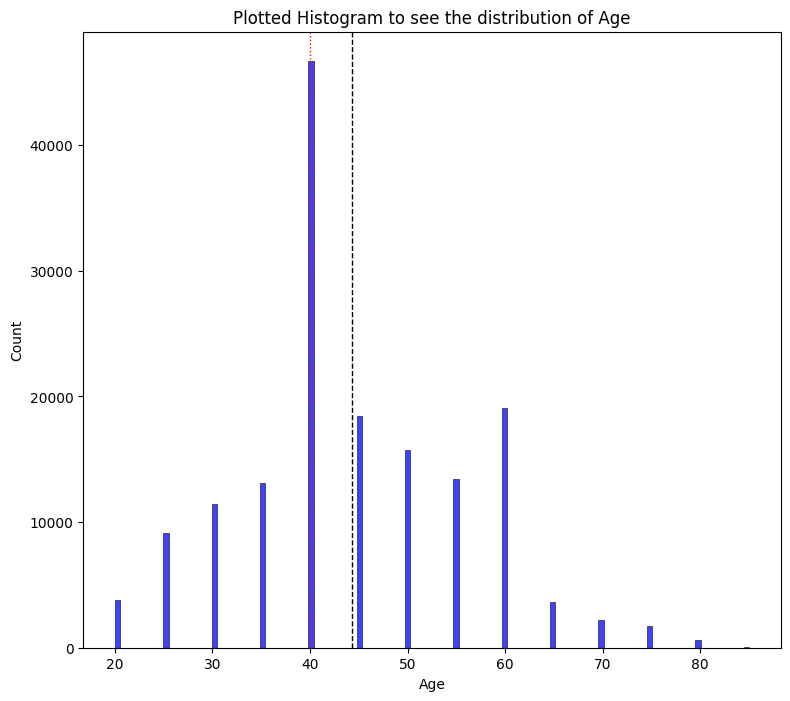

-----------------------------------------------------
The mean of Age : 44.30662581001658
The median of Age : 40.0
The iqr of Age : 15.0
Max value of Age : 85
Min value of Age : 20


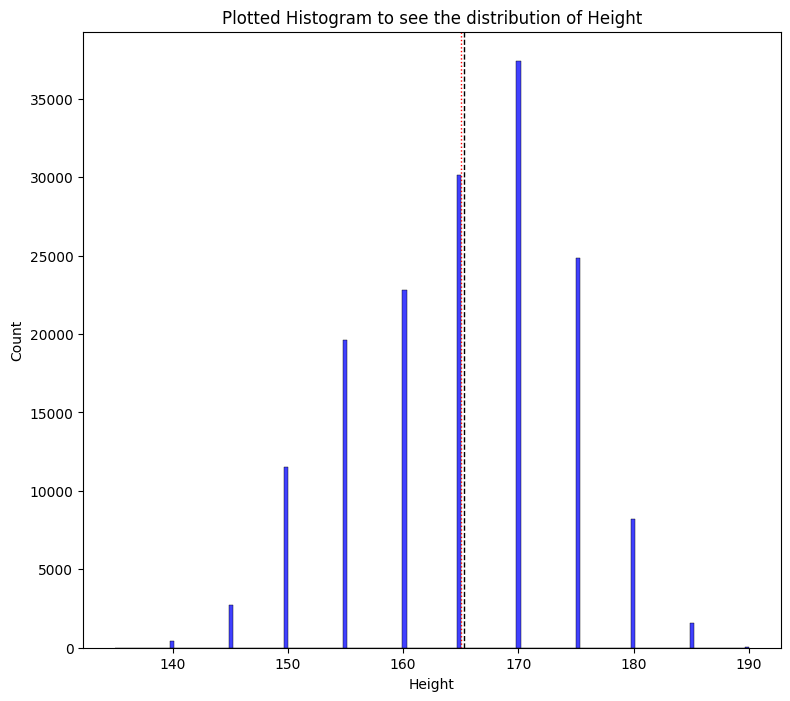

-----------------------------------------------------
The mean of Height : 165.2669287185412
The median of Height : 165.0
The iqr of Height : 10.0
Max value of Height : 190
Min value of Height : 135


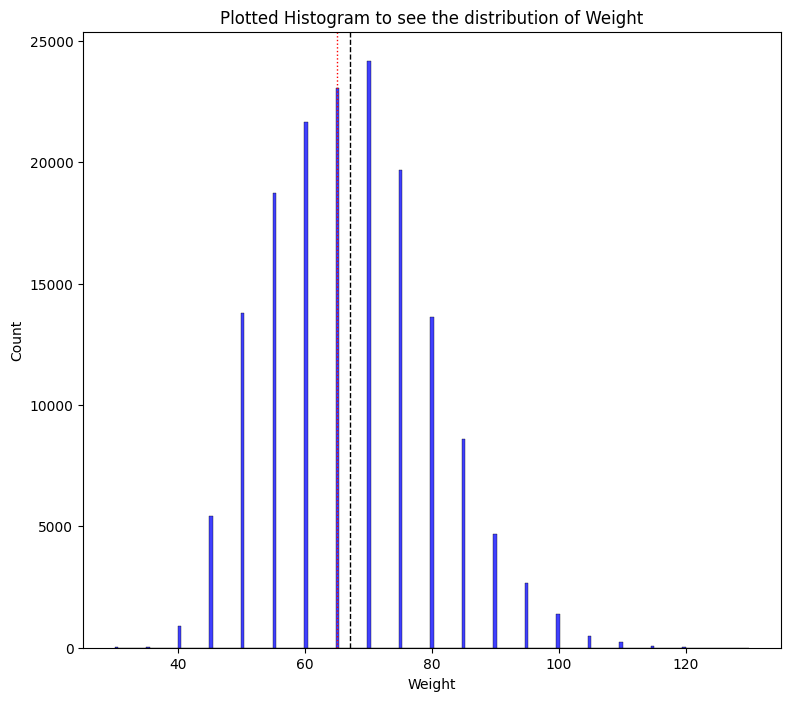

-----------------------------------------------------
The mean of Weight : 67.14366177726428
The median of Weight : 65.0
The iqr of Weight : 15.0
Max value of Weight : 130
Min value of Weight : 30


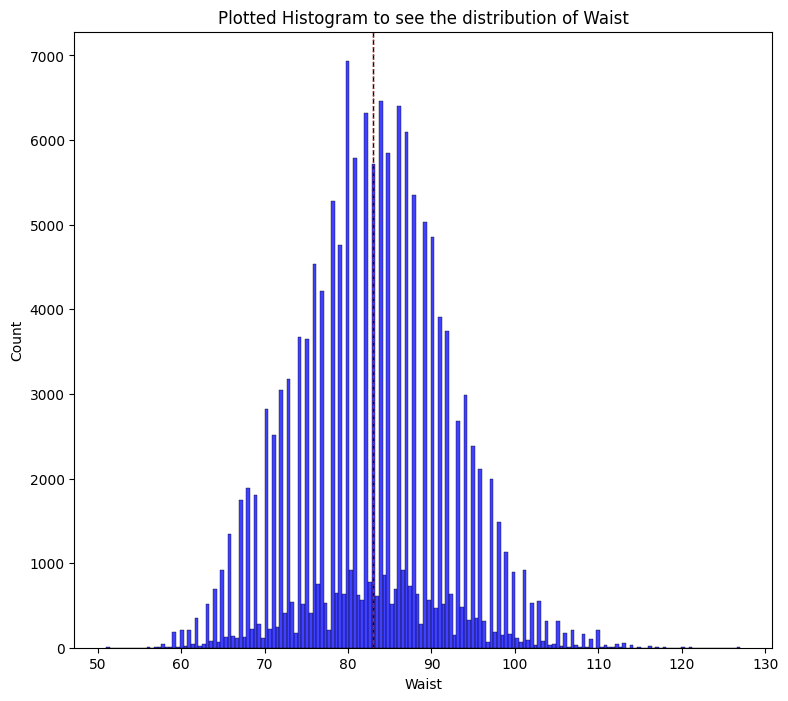

-----------------------------------------------------
The mean of Waist : 83.00198987793239
The median of Waist : 83.0
The iqr of Waist : 12.0
Max value of Waist : 127.0
Min value of Waist : 51.0


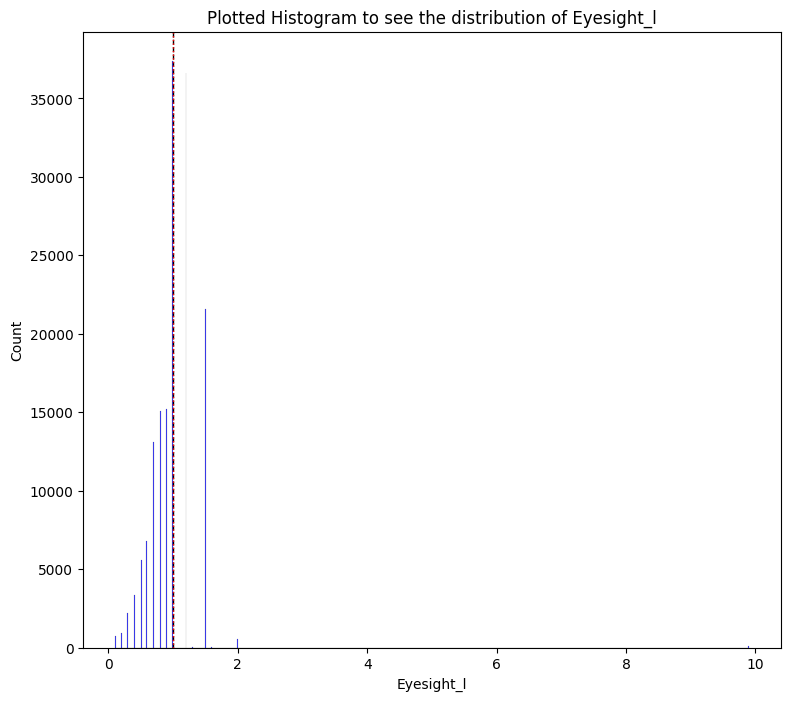

-----------------------------------------------------
The mean of Eyesight_l : 1.005798211684332
The median of Eyesight_l : 1.0
The iqr of Eyesight_l : 0.3999999999999999
Max value of Eyesight_l : 9.9
Min value of Eyesight_l : 0.1


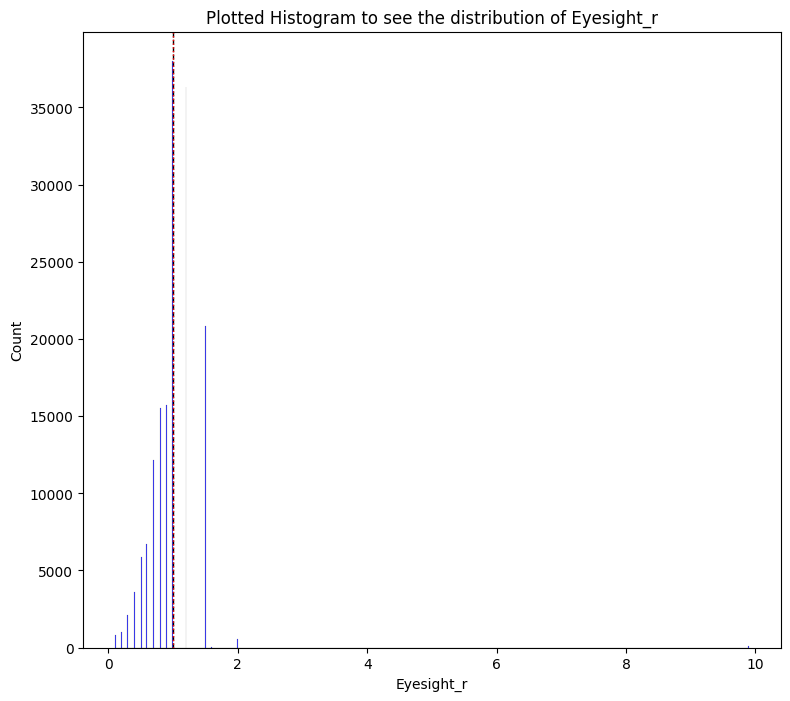

-----------------------------------------------------
The mean of Eyesight_r : 1.0009889737278344
The median of Eyesight_r : 1.0
The iqr of Eyesight_r : 0.3999999999999999
Max value of Eyesight_r : 9.9
Min value of Eyesight_r : 0.1


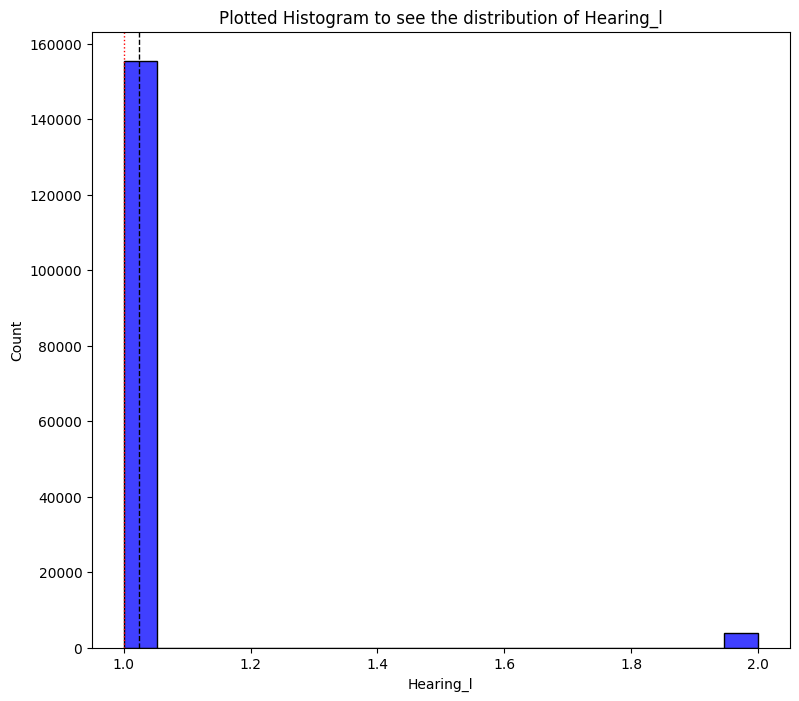

-----------------------------------------------------
The mean of Hearing_l : 1.023973979002361
The median of Hearing_l : 1.0
The iqr of Hearing_l : 0.0
Max value of Hearing_l : 2
Min value of Hearing_l : 1


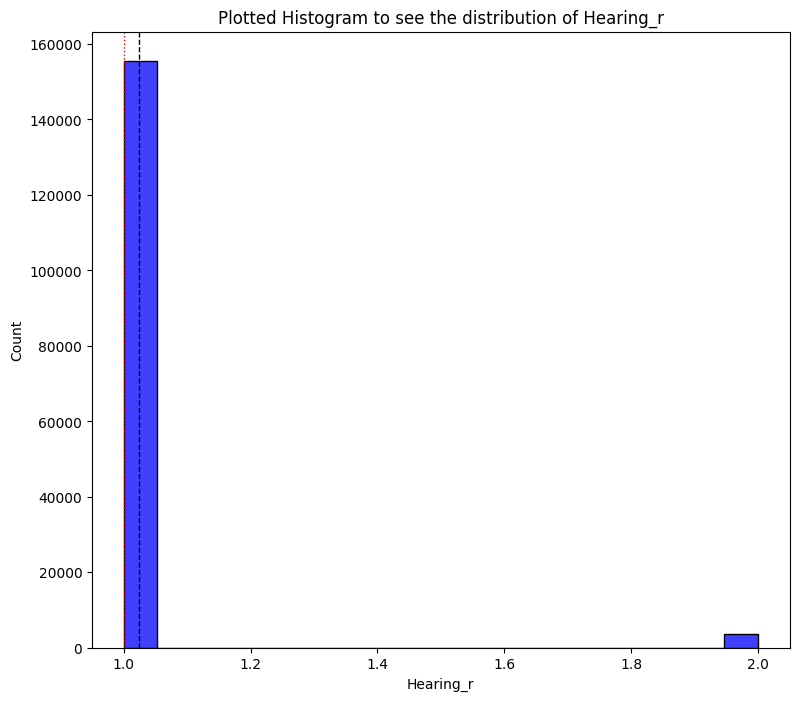

-----------------------------------------------------
The mean of Hearing_r : 1.023421409554428
The median of Hearing_r : 1.0
The iqr of Hearing_r : 0.0
Max value of Hearing_r : 2
Min value of Hearing_r : 1


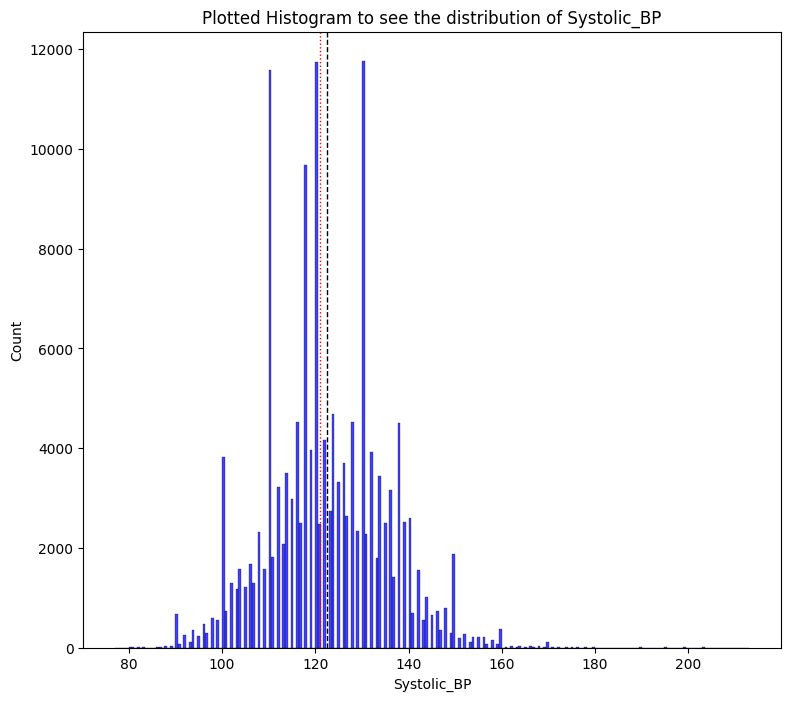

-----------------------------------------------------
The mean of Systolic_BP : 122.503648214196
The median of Systolic_BP : 121.0
The iqr of Systolic_BP : 16.0
Max value of Systolic_BP : 213
Min value of Systolic_BP : 77


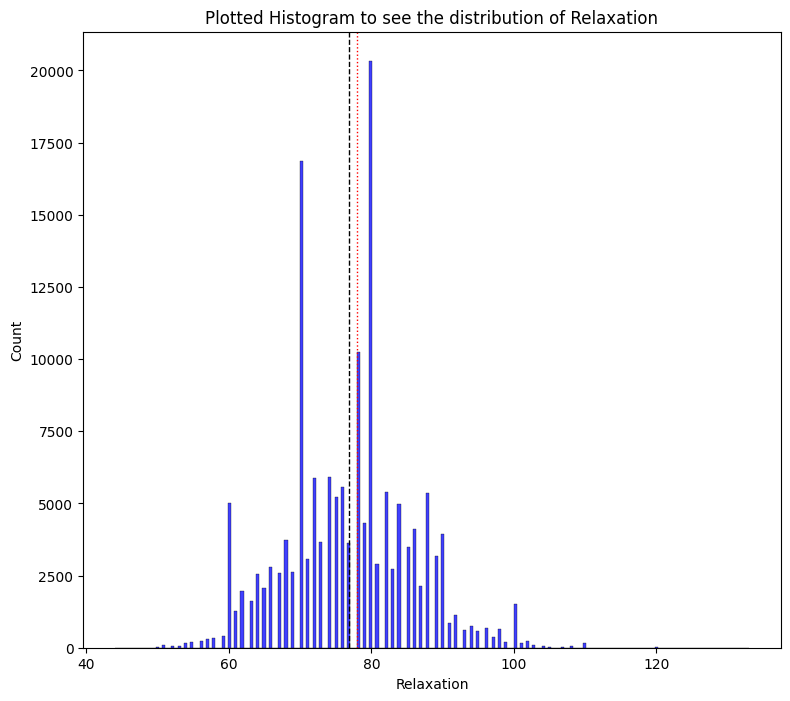

-----------------------------------------------------
The mean of Relaxation : 76.87407067865576
The median of Relaxation : 78.0
The iqr of Relaxation : 12.0
Max value of Relaxation : 133
Min value of Relaxation : 44


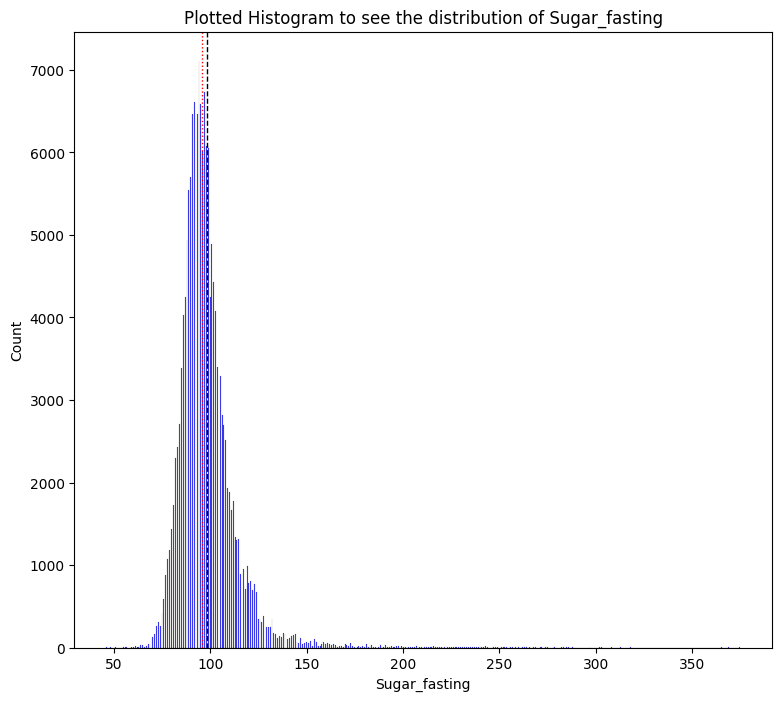

-----------------------------------------------------
The mean of Sugar_fasting : 98.35255186617772
The median of Sugar_fasting : 96.0
The iqr of Sugar_fasting : 13.0
Max value of Sugar_fasting : 375
Min value of Sugar_fasting : 46


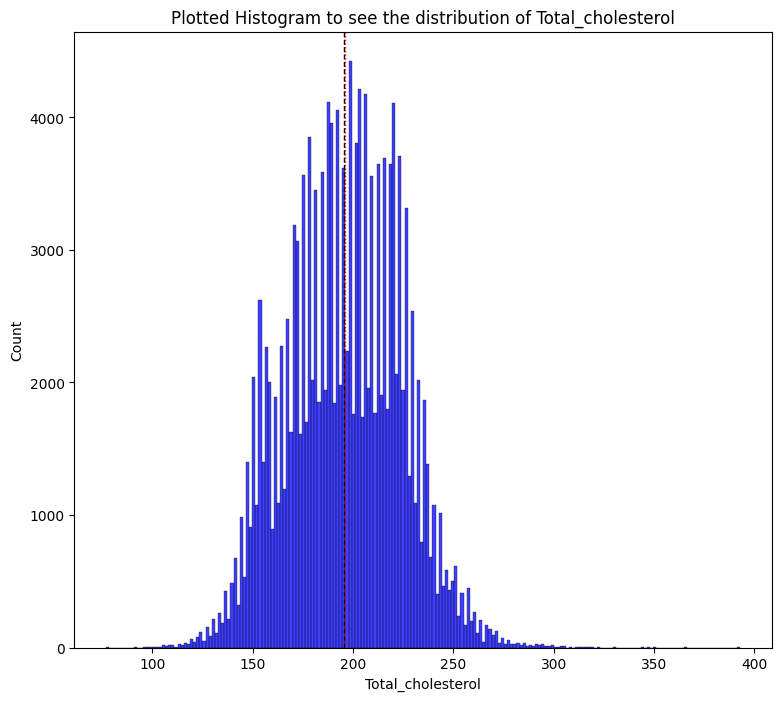

-----------------------------------------------------
The mean of Total_cholesterol : 195.79616466569547
The median of Total_cholesterol : 196.0
The iqr of Total_cholesterol : 42.0
Max value of Total_cholesterol : 393
Min value of Total_cholesterol : 77


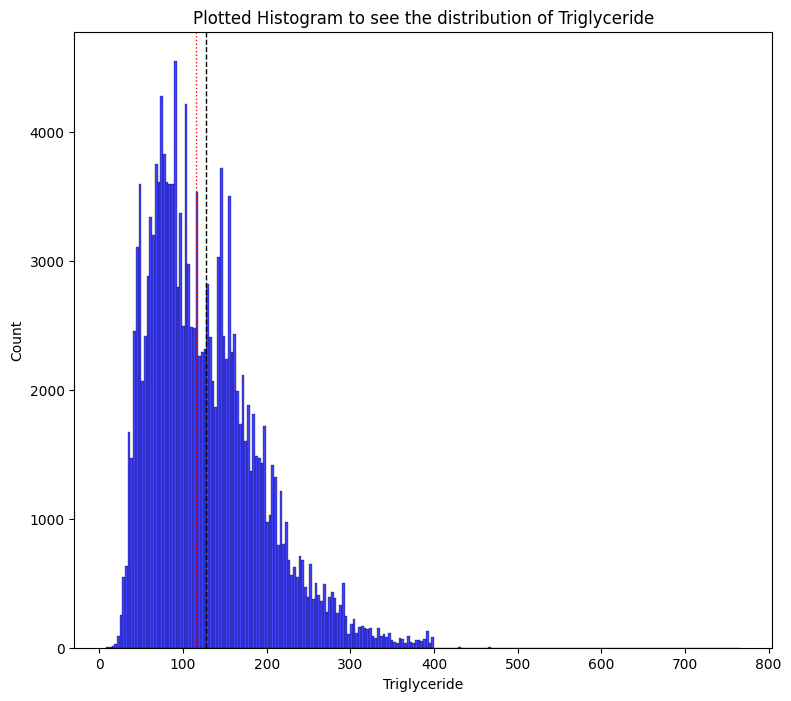

-----------------------------------------------------
The mean of Triglyceride : 127.61604586326418
The median of Triglyceride : 115.0
The iqr of Triglyceride : 88.0
Max value of Triglyceride : 766
Min value of Triglyceride : 8


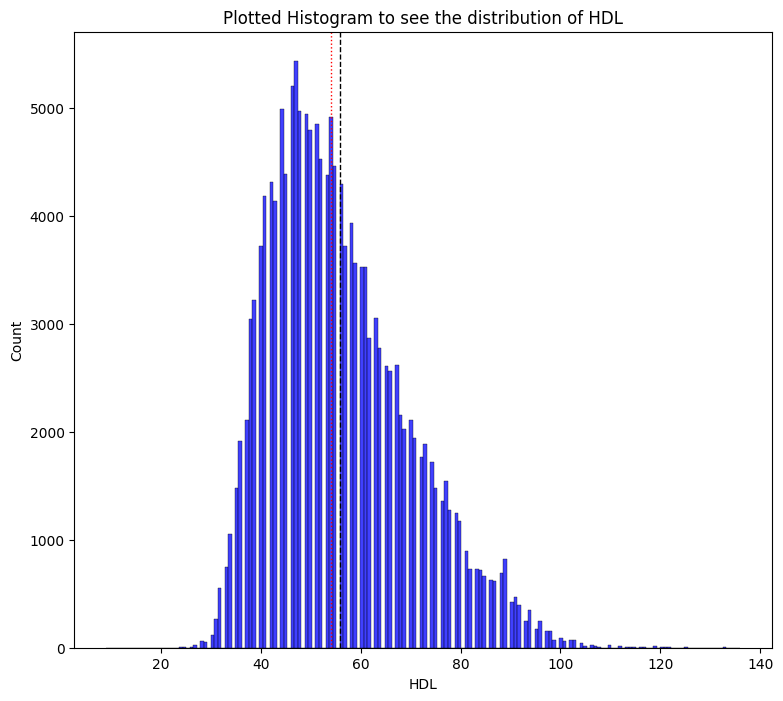

-----------------------------------------------------
The mean of HDL : 55.852683729341436
The median of HDL : 54.0
The iqr of HDL : 19.0
Max value of HDL : 136
Min value of HDL : 9


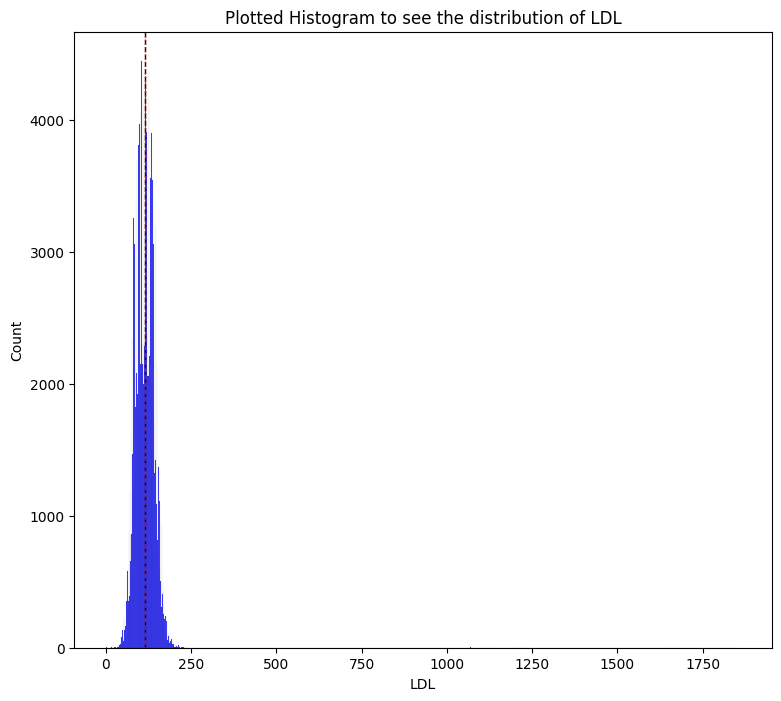

-----------------------------------------------------
The mean of LDL : 114.60768197116592
The median of LDL : 114.0
The iqr of LDL : 38.0
Max value of LDL : 1860
Min value of LDL : 1


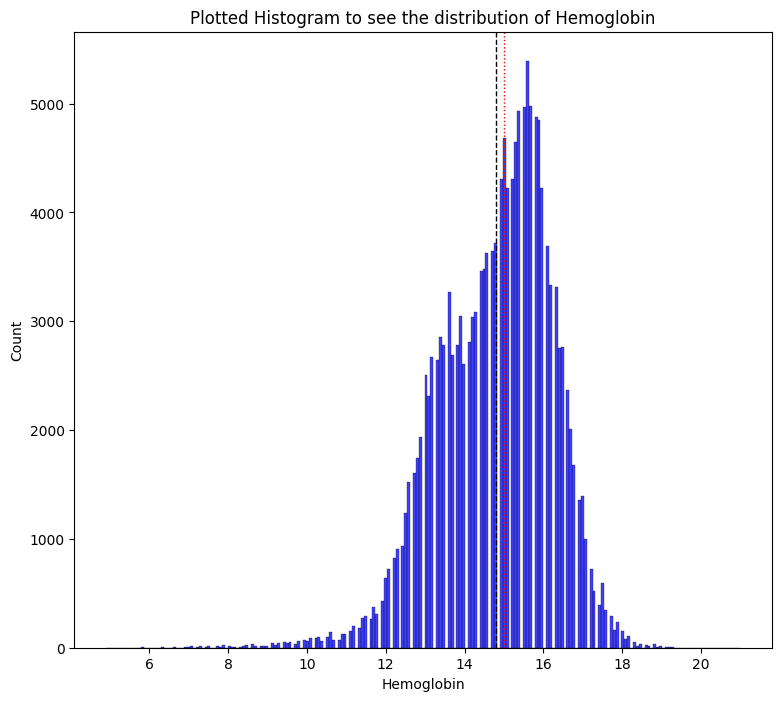

-----------------------------------------------------
The mean of Hemoglobin : 14.796965263475157
The median of Hemoglobin : 15.0
The iqr of Hemoglobin : 2.0
Max value of Hemoglobin : 21.0
Min value of Hemoglobin : 4.9


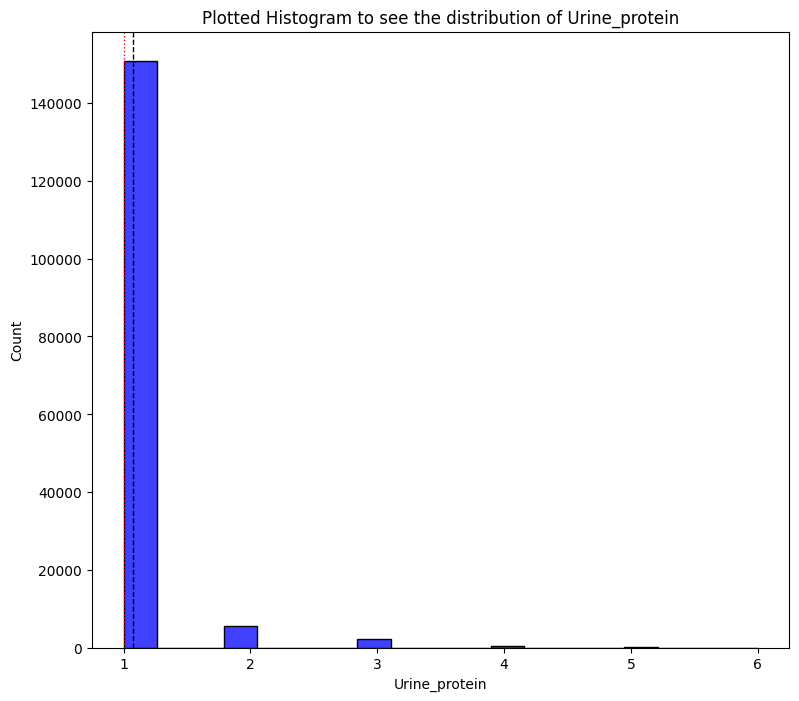

-----------------------------------------------------
The mean of Urine_protein : 1.0742326819711658
The median of Urine_protein : 1.0
The iqr of Urine_protein : 0.0
Max value of Urine_protein : 6
Min value of Urine_protein : 1


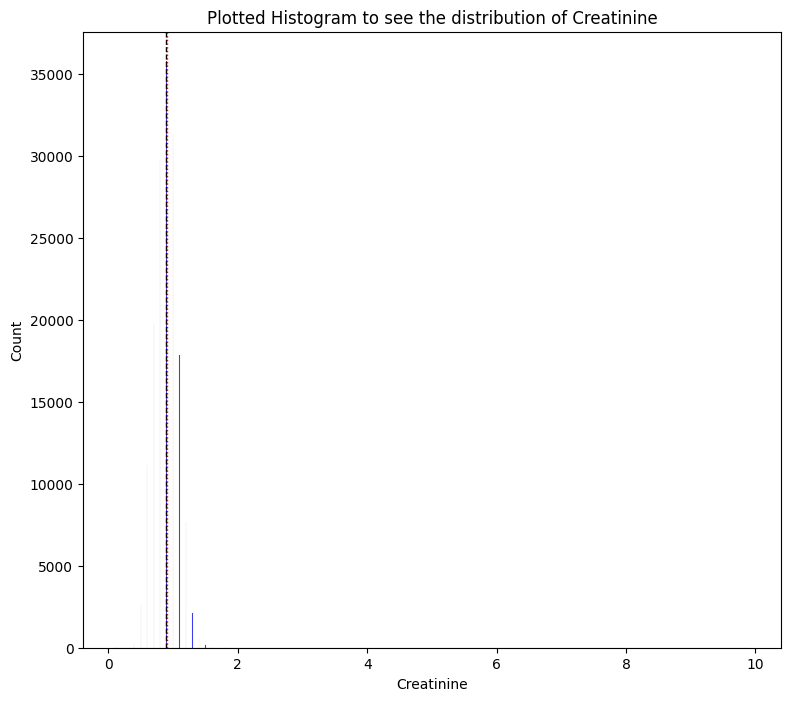

-----------------------------------------------------
The mean of Creatinine : 0.8927644798312152
The median of Creatinine : 0.9
The iqr of Creatinine : 0.19999999999999996
Max value of Creatinine : 9.9
Min value of Creatinine : 0.1


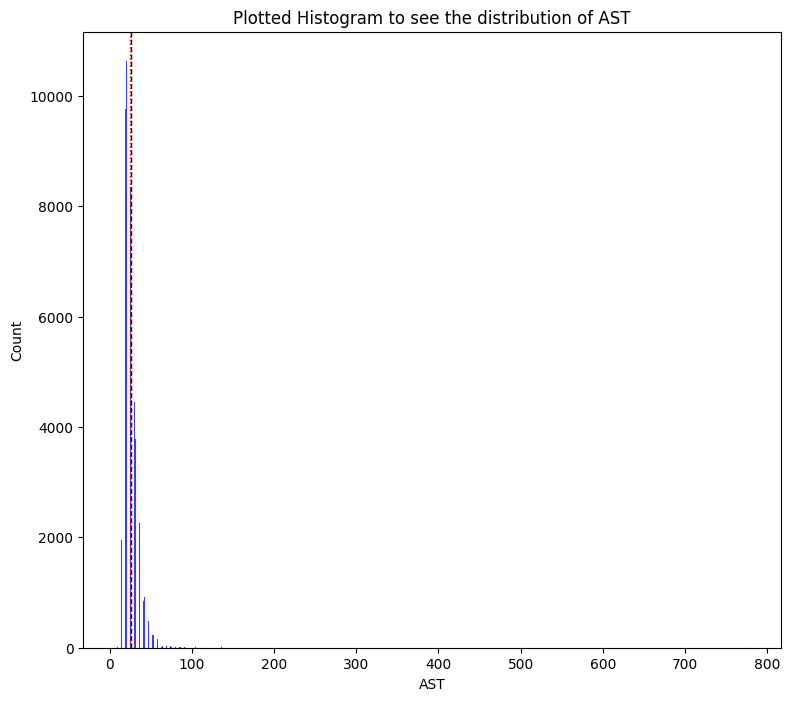

-----------------------------------------------------
The mean of AST : 25.516853368161954
The median of AST : 24.0
The iqr of AST : 9.0
Max value of AST : 778
Min value of AST : 6


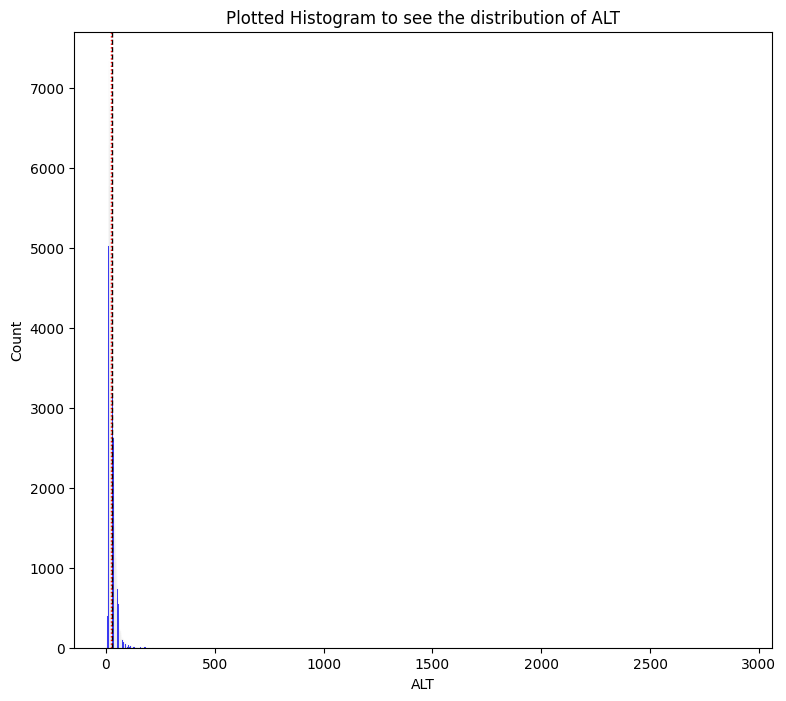

-----------------------------------------------------
The mean of ALT : 26.550296378158436
The median of ALT : 22.0
The iqr of ALT : 16.0
Max value of ALT : 2914
Min value of ALT : 1


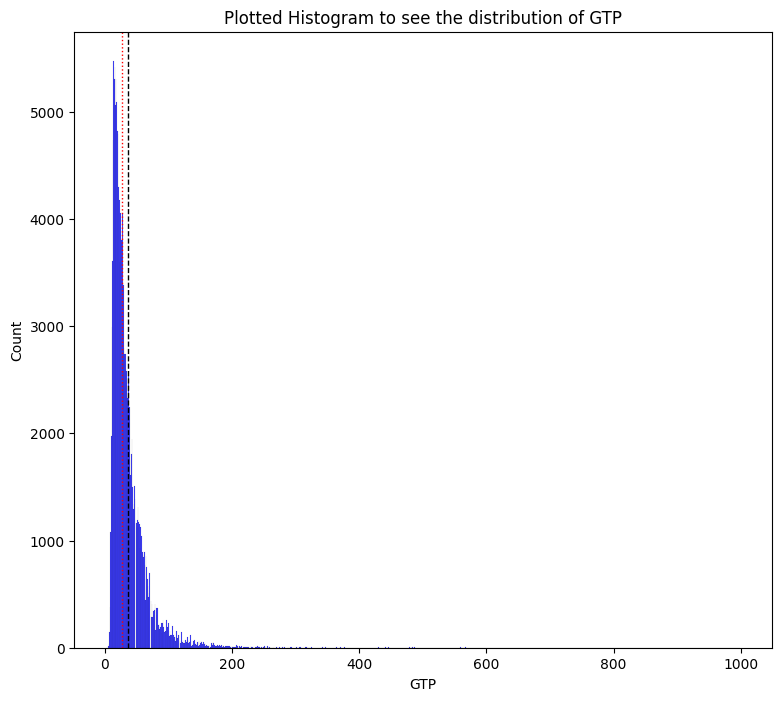

-----------------------------------------------------
The mean of GTP : 36.216004420555585
The median of GTP : 27.0
The iqr of GTP : 26.0
Max value of GTP : 999
Min value of GTP : 2


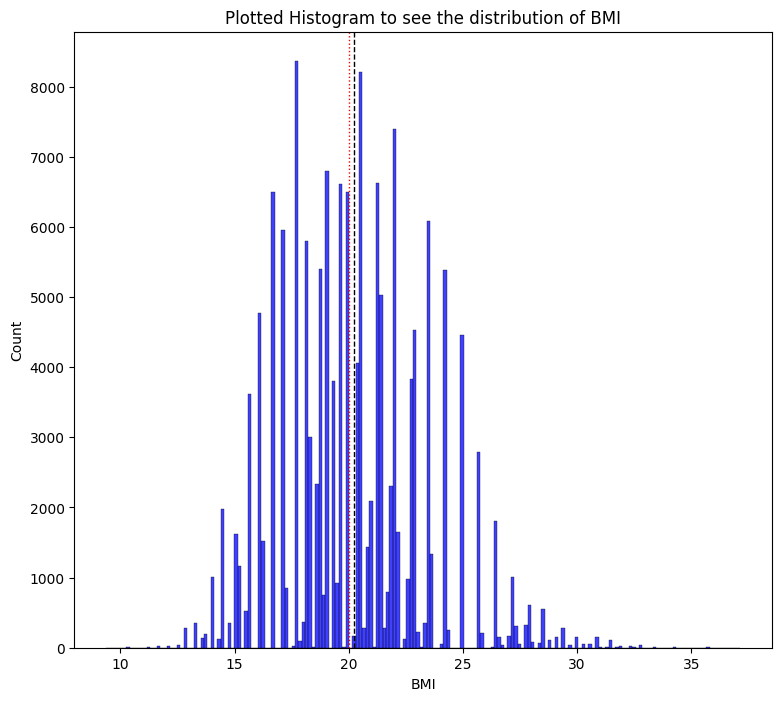

-----------------------------------------------------
The mean of BMI : 20.231123166574488
The median of BMI : 20.0
The iqr of BMI : 4.003267973856211
Max value of BMI : 37.142857142857146
Min value of BMI : 9.375


In [ ]:
for i in num_smoker.columns : ## Creating the for loop .
  plt.figure(figsize=(9,8))   ## Selecting the size of each plot .
  sns.histplot(data=num_smoker,x=i,color='blue')
  plt.axvline(x=num_smoker[i].mean(),linewidth=1,color='black',linestyle='dashed') ## Creating a line for mean .
  plt.axvline(x=num_smoker[i].median(),linewidth=1,color='red',linestyle='dotted') ## Creating aline for median .
  plt.title(f"Plotted Histogram to see the distribution of {i}")
  plt.show() ## show will show all the visuals .
  print("-----------------------------------------------------")
  print(f"The mean of {i} :", num_smoker[i].mean())
  print(f"The median of {i} :", num_smoker[i].median())
  print(f"The iqr of {i} :", np.percentile(num_smoker[i],75,interpolation='midpoint')-np.percentile(num_smoker[i],25,interpolation='midpoint'))
  print(f"Max value of {i} :", num_smoker[i].max())
  print(f"Min value of {i} :", num_smoker[i].min())

We can clearly see that 'Triglyceride','LDL','AST','ALT','GTP' all these columns has some extreme values in their right . so we can say these columns are positively skewd or right skewd because they has a very long tail towards their right . In right skewed data Mean is greater than median .

'Hemoglobin' is left skewed column or it means it's values are mainly in lower part . In left skewed columns Median is greater than mean .


In [ ]:
skewed_columns=['Triglyceride','LDL','AST','ALT','GTP'] ## Creating a list of columns which are skewed .

Creating a for loop with boxplot for all the columns to visualize the outliers in positive and negative side .

In Normal distribution 99.7% datapoint falls between (mean-3sd) to (mean+3sd) . That's why i have also printed the values of (mean-3sd) and (mean+3sd) for each column .

To get the outliers the equation is (q3+1.5*iqr) and (q1-1.5*iqr) . Any values above (q3+1.5*iqr) and any values less than (q1-1.5*iqr) can be considerd as an outlier .

I have also printed the values of positive outlier and skewness for each column .

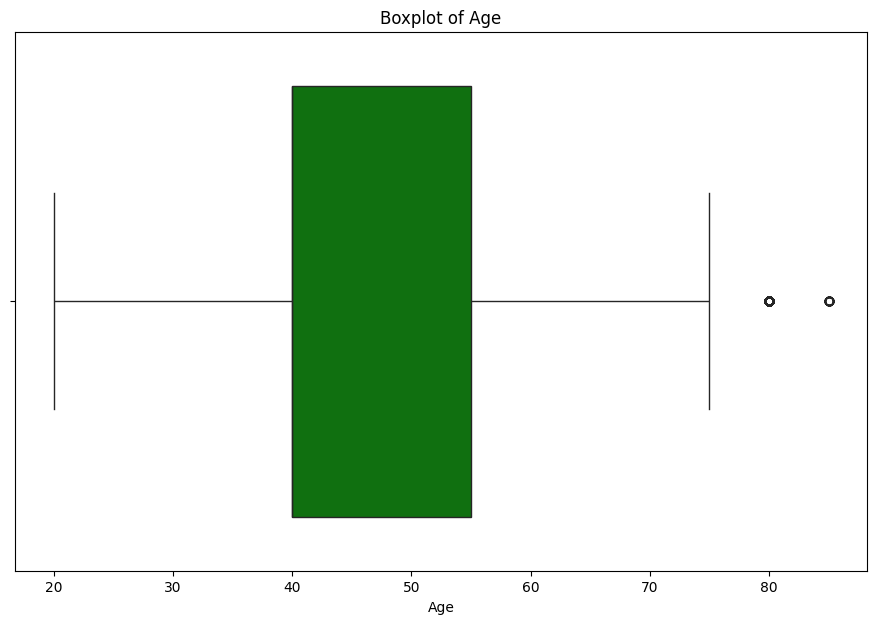

------------------------------------------
Plus 3 standard_deviation value of Age from mean : 79.83348334879543
Minus 3 standard deviation value of Age from mean : 8.779768271237721
Positive outliers value in Age : 77.5
Skewness in Age : 0.2916973461458878


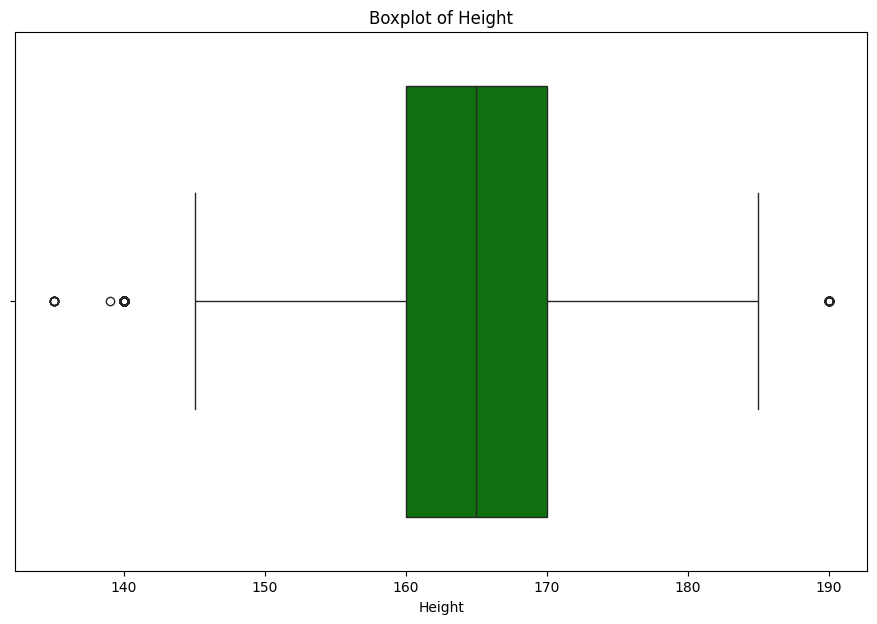

------------------------------------------
Plus 3 standard_deviation value of Height from mean : 191.72383825413007
Minus 3 standard deviation value of Height from mean : 138.81001918295235
Positive outliers value in Height : 185.0
Skewness in Height : -0.2699148051800865


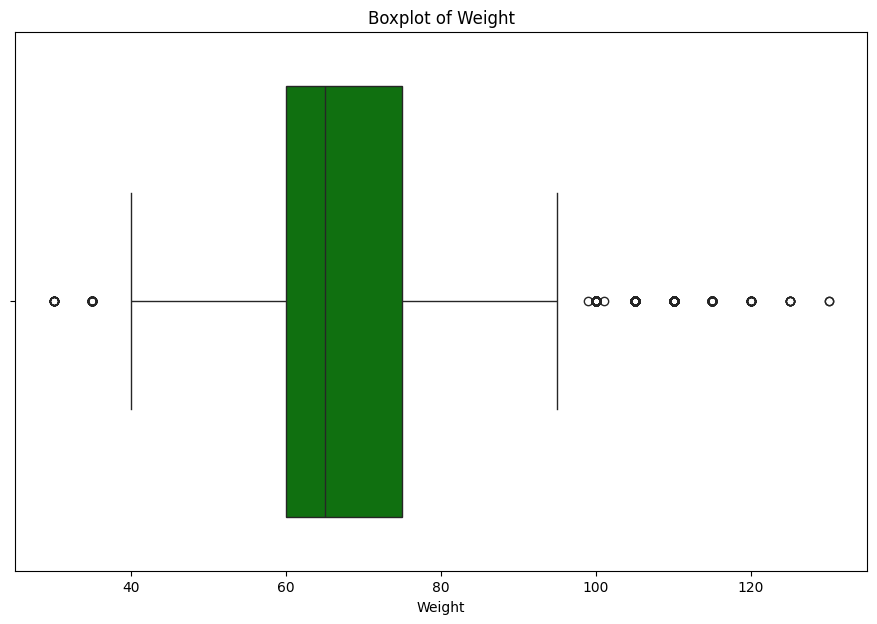

------------------------------------------
Plus 3 standard_deviation value of Weight from mean : 104.90225620392462
Minus 3 standard deviation value of Weight from mean : 29.38506735060394
Positive outliers value in Weight : 97.5
Skewness in Weight : 0.37807475043098937


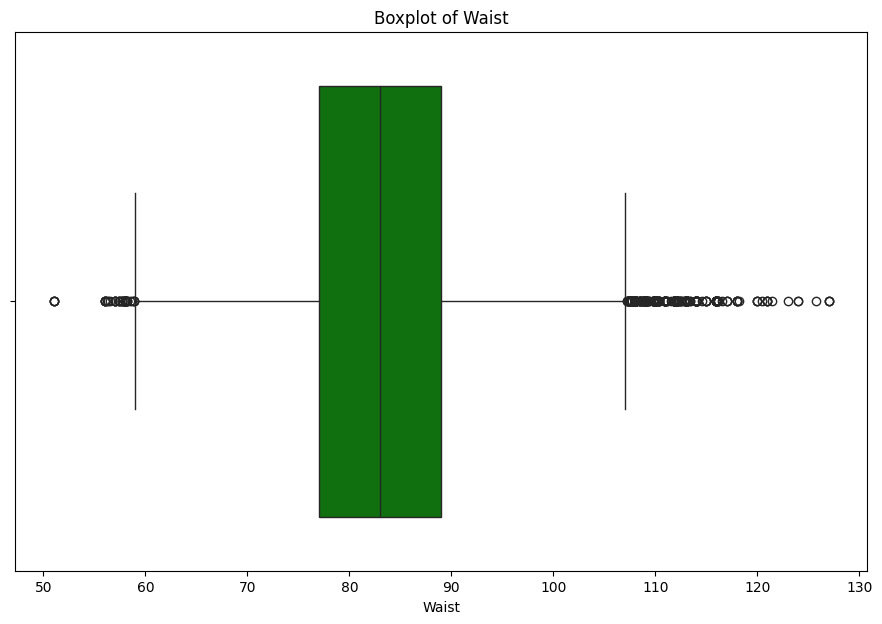

------------------------------------------
Plus 3 standard_deviation value of Waist from mean : 109.87580166163148
Minus 3 standard deviation value of Waist from mean : 56.12817809423329
Positive outliers value in Waist : 107.0
Skewness in Waist : 0.07244589379014092


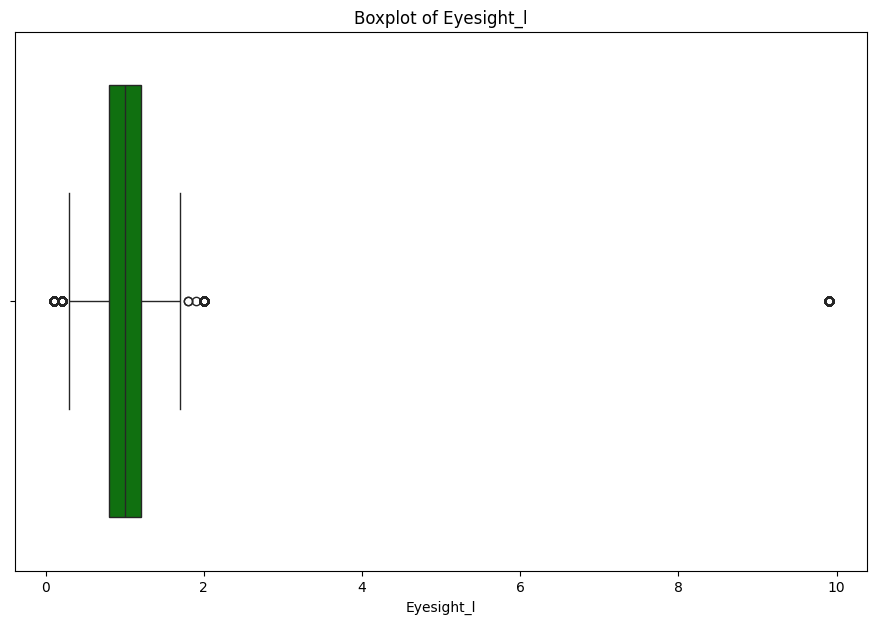

------------------------------------------
Plus 3 standard_deviation value of Eyesight_l from mean : 2.2121360461946047
Minus 3 standard deviation value of Eyesight_l from mean : -0.20053962282594084
Positive outliers value in Eyesight_l : 1.7999999999999998
Skewness in Eyesight_l : 8.890572430701148


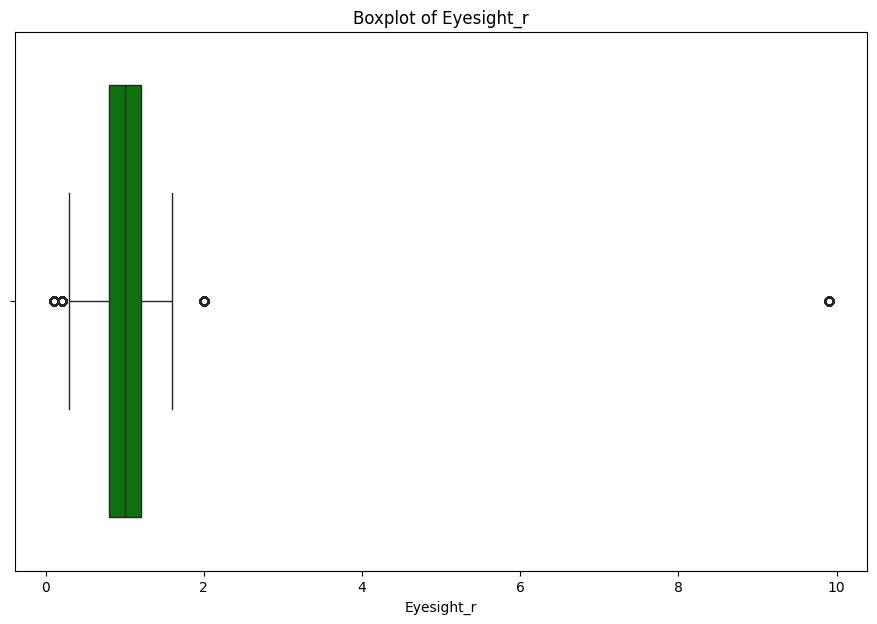

------------------------------------------
Plus 3 standard_deviation value of Eyesight_r from mean : 2.17788471945308
Minus 3 standard deviation value of Eyesight_r from mean : -0.175906771997411
Positive outliers value in Eyesight_r : 1.7999999999999998
Skewness in Eyesight_r : 8.486849095554883


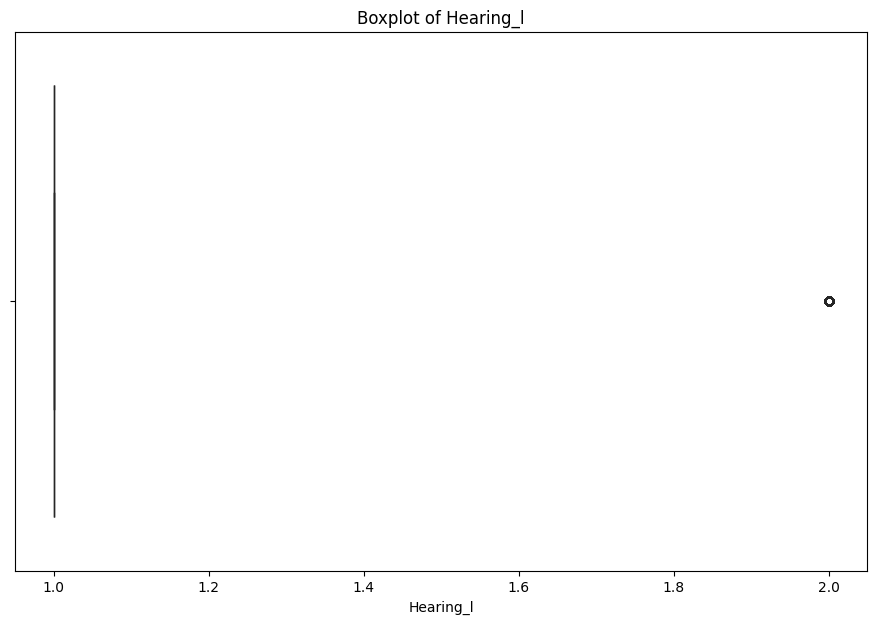

------------------------------------------
Plus 3 standard_deviation value of Hearing_l from mean : 1.4828795993233501
Minus 3 standard deviation value of Hearing_l from mean : 0.5650683586813718
Positive outliers value in Hearing_l : 1.0
Skewness in Hearing_l : 6.2239202761990695


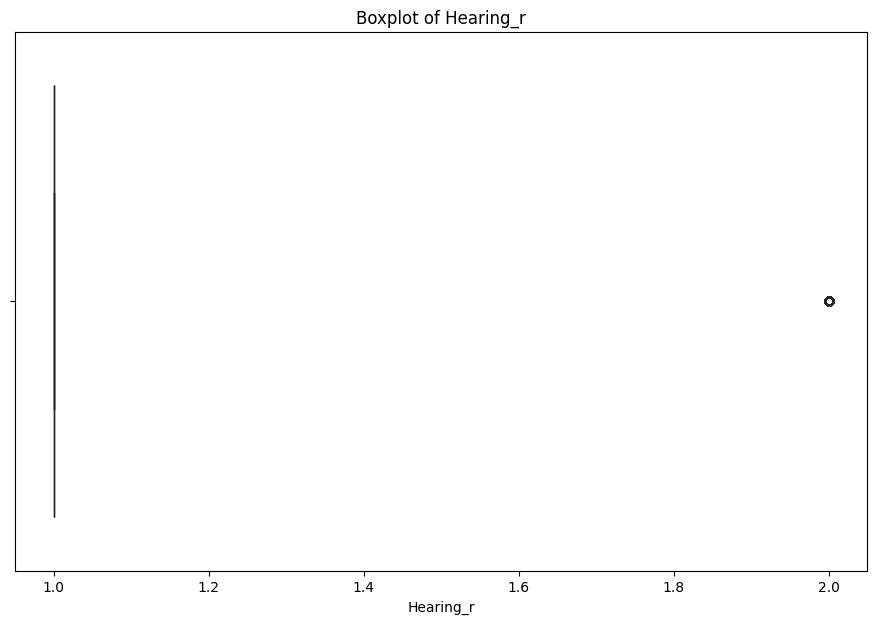

------------------------------------------
Plus 3 standard_deviation value of Hearing_r from mean : 1.477135985886953
Minus 3 standard deviation value of Hearing_r from mean : 0.5697068332219031
Positive outliers value in Hearing_r : 1.0
Skewness in Hearing_r : 6.302436824084392


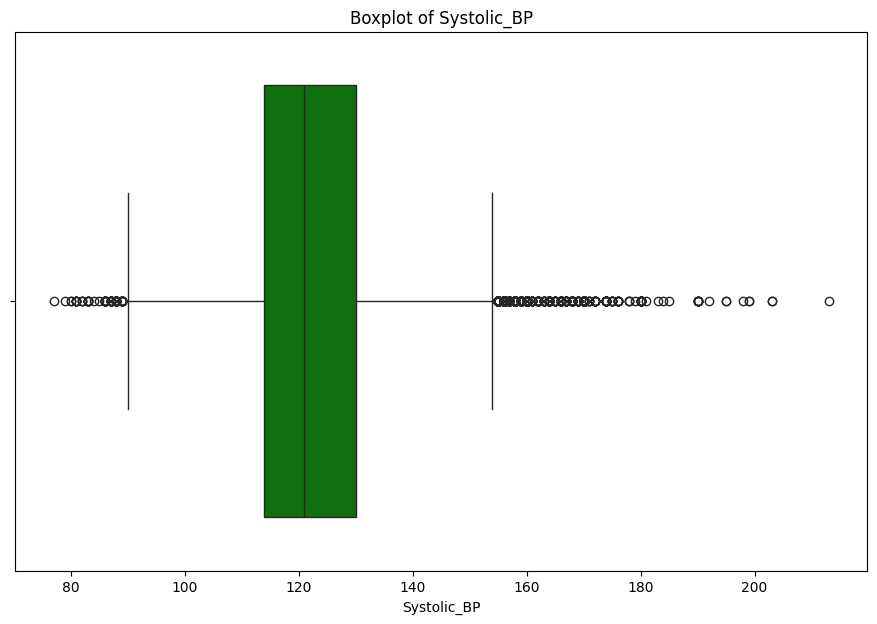

------------------------------------------
Plus 3 standard_deviation value of Systolic_BP from mean : 160.6915936872261
Minus 3 standard deviation value of Systolic_BP from mean : 84.31570274116592
Positive outliers value in Systolic_BP : 154.0
Skewness in Systolic_BP : 0.21992481204281342


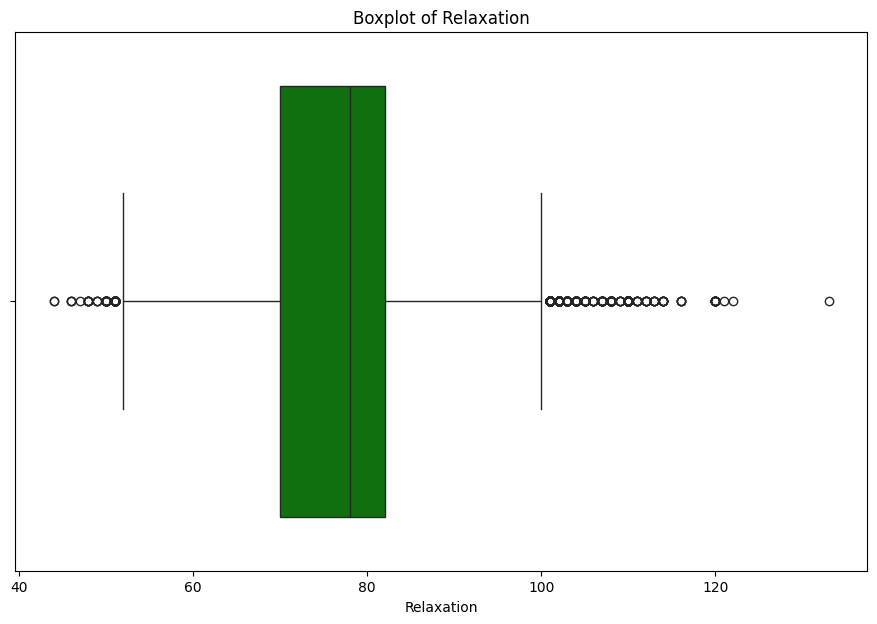

------------------------------------------
Plus 3 standard_deviation value of Relaxation from mean : 103.85799574119537
Minus 3 standard deviation value of Relaxation from mean : 49.890145616116136
Positive outliers value in Relaxation : 100.0
Skewness in Relaxation : 0.17634977480941716


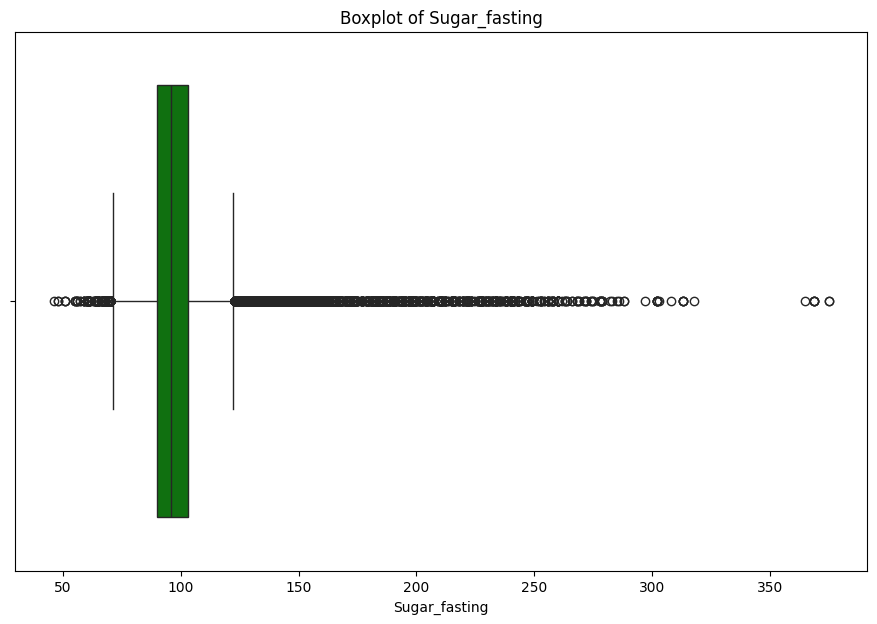

------------------------------------------
Plus 3 standard_deviation value of Sugar_fasting from mean : 144.34177233302051
Minus 3 standard deviation value of Sugar_fasting from mean : 52.36333139933493
Positive outliers value in Sugar_fasting : 122.5
Skewness in Sugar_fasting : 3.461099039475446


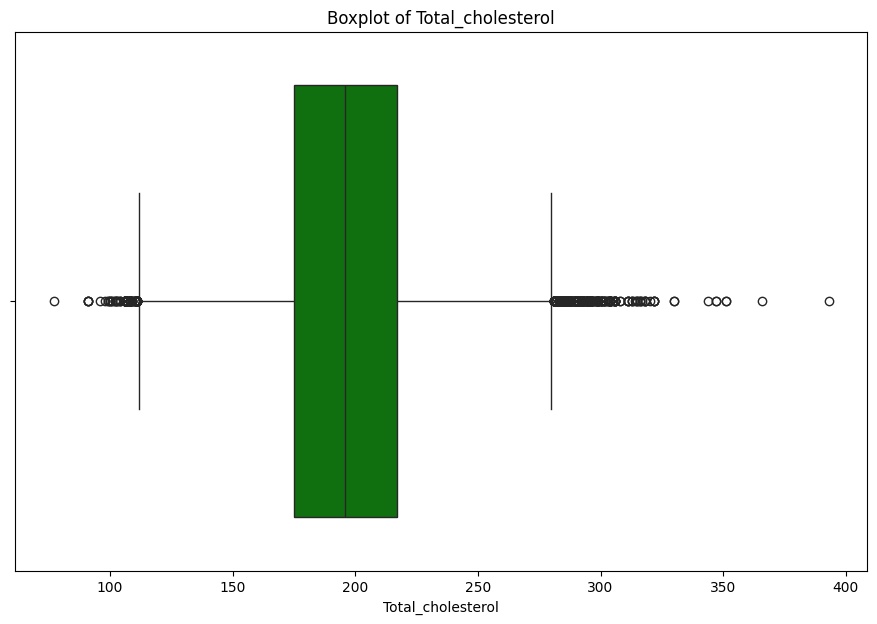

------------------------------------------
Plus 3 standard_deviation value of Total_cholesterol from mean : 280.98704191435417
Minus 3 standard deviation value of Total_cholesterol from mean : 110.60528741703678
Positive outliers value in Total_cholesterol : 280.0
Skewness in Total_cholesterol : 0.043487788578322334


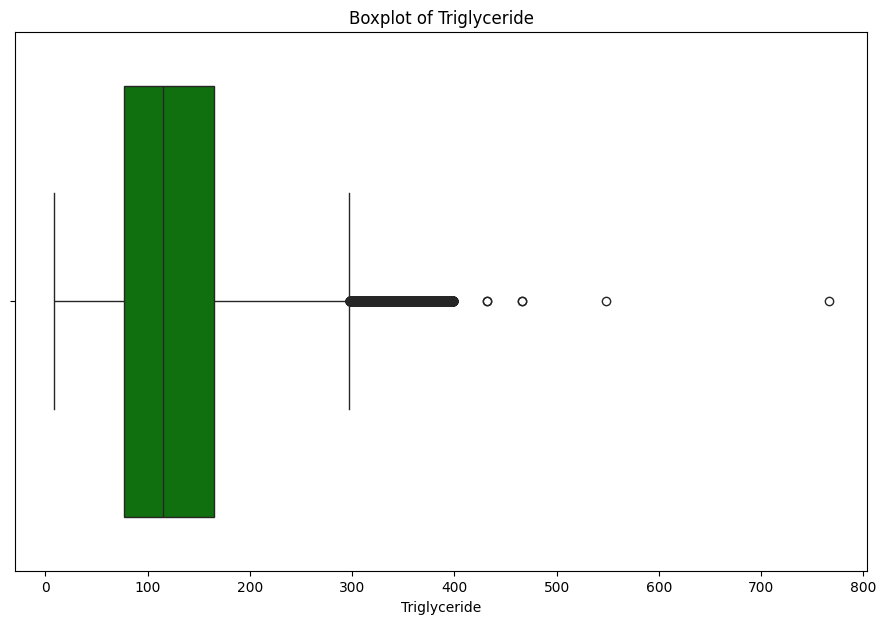

------------------------------------------
Plus 3 standard_deviation value of Triglyceride from mean : 326.1830132572953
Minus 3 standard deviation value of Triglyceride from mean : -70.95092153076693
Positive outliers value in Triglyceride : 297.0
Skewness in Triglyceride : 0.986227749457496


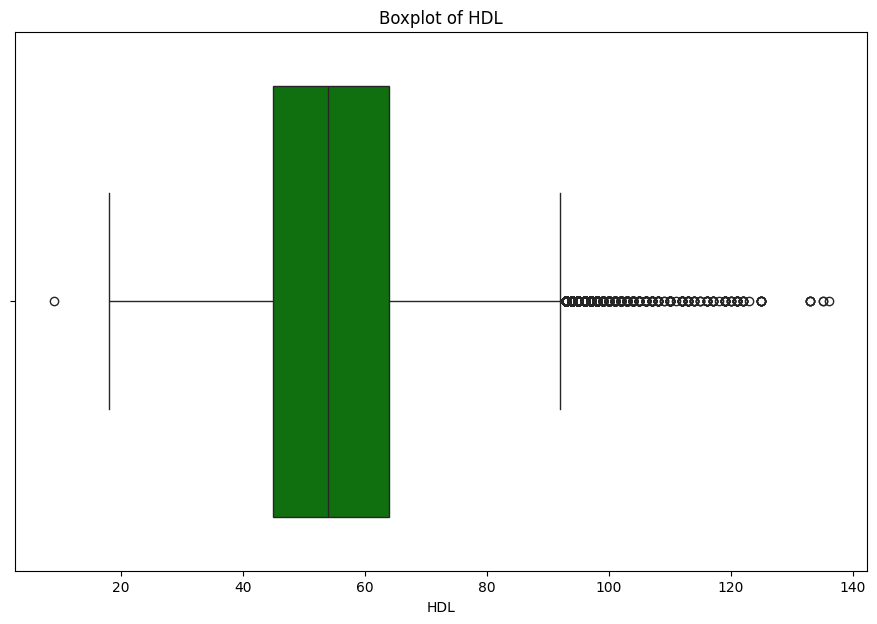

------------------------------------------
Plus 3 standard_deviation value of HDL from mean : 97.74510695418346
Minus 3 standard deviation value of HDL from mean : 13.96026050449941
Positive outliers value in HDL : 92.5
Skewness in HDL : 0.7588840782124779


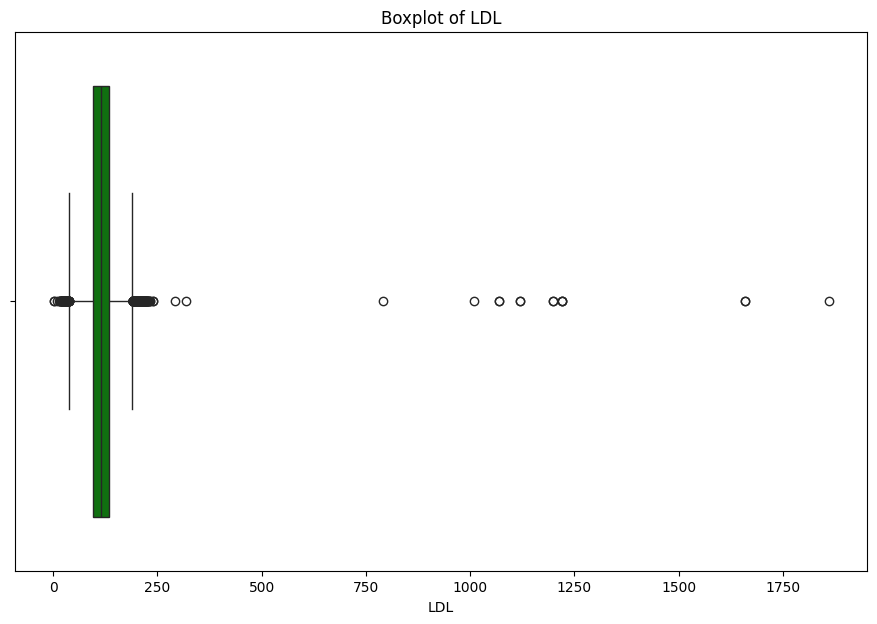

------------------------------------------
Plus 3 standard_deviation value of LDL from mean : 199.08447616567895
Minus 3 standard deviation value of LDL from mean : 30.13088777665287
Positive outliers value in LDL : 190.0
Skewness in LDL : 6.8748102130205035


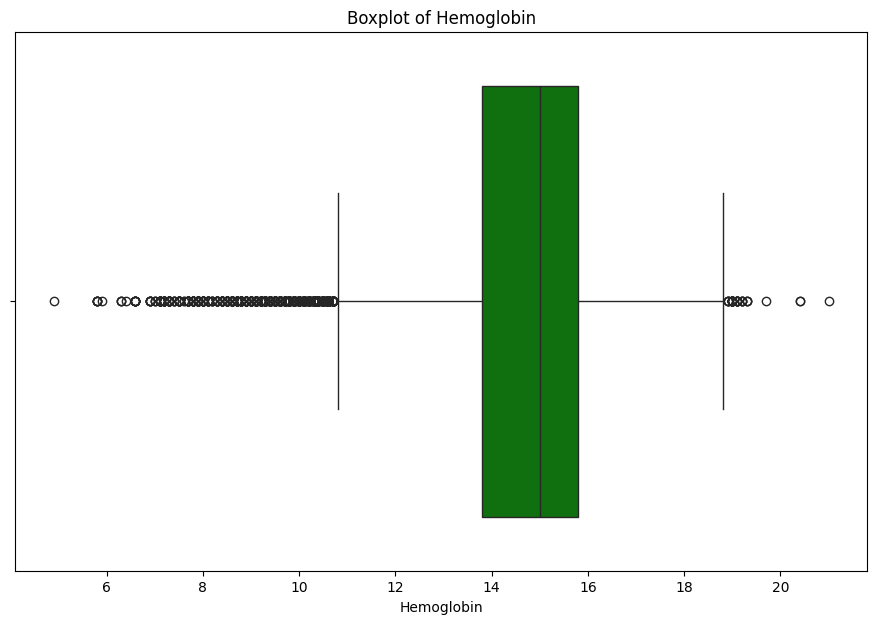

------------------------------------------
Plus 3 standard_deviation value of Hemoglobin from mean : 19.090604495312142
Minus 3 standard deviation value of Hemoglobin from mean : 10.503326031638172
Positive outliers value in Hemoglobin : 18.8
Skewness in Hemoglobin : -0.6335705633670662


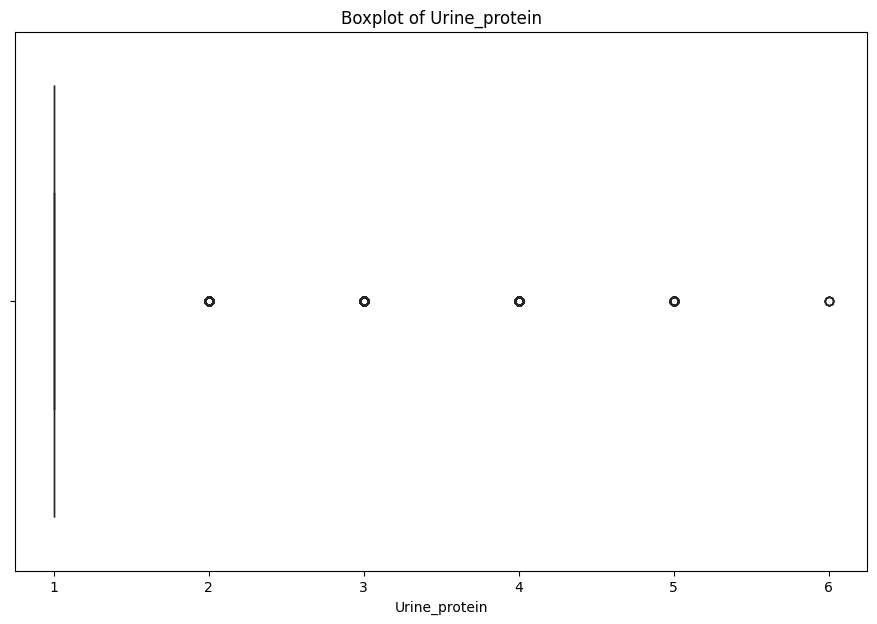

------------------------------------------
Plus 3 standard_deviation value of Urine_protein from mean : 2.1177996417998353
Minus 3 standard deviation value of Urine_protein from mean : 0.030665722142496632
Positive outliers value in Urine_protein : 1.0
Skewness in Urine_protein : 5.585562420844458


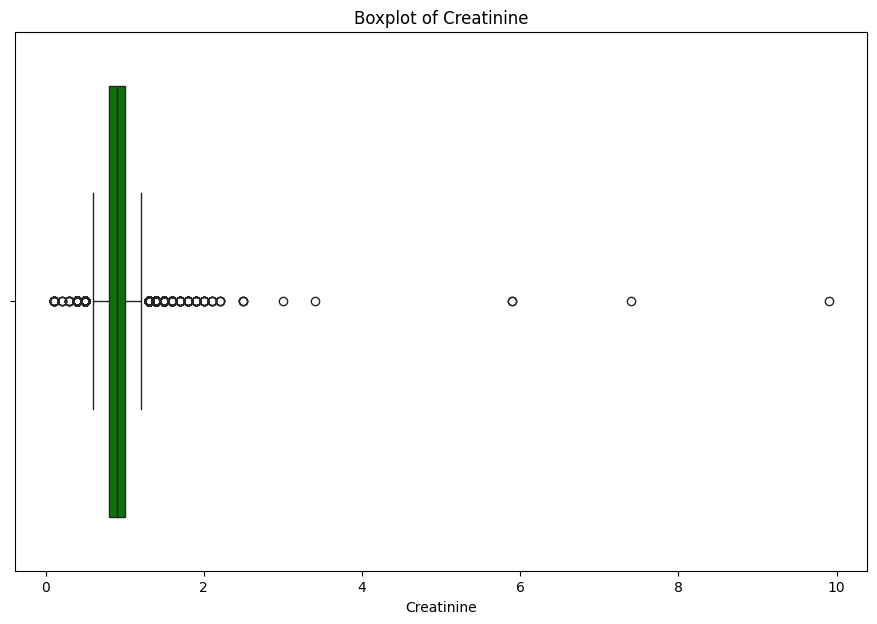

------------------------------------------
Plus 3 standard_deviation value of Creatinine from mean : 1.4308023428331678
Minus 3 standard deviation value of Creatinine from mean : 0.35472661682926265
Positive outliers value in Creatinine : 1.2999999999999998
Skewness in Creatinine : 1.5110590703323046


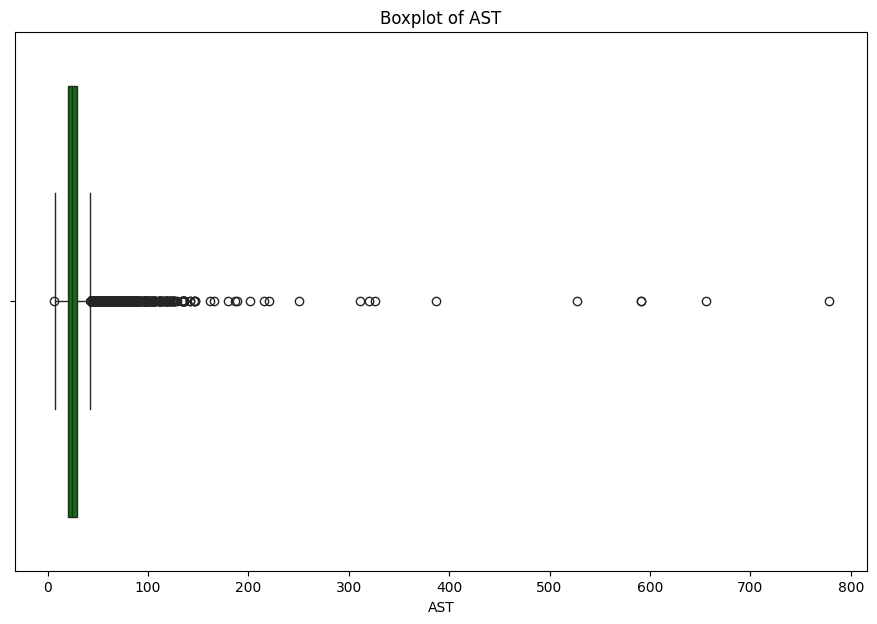

------------------------------------------
Plus 3 standard_deviation value of AST from mean : 53.91149960224917
Minus 3 standard deviation value of AST from mean : -2.877792865925265
Positive outliers value in AST : 42.5
Skewness in AST : 11.59234569223128


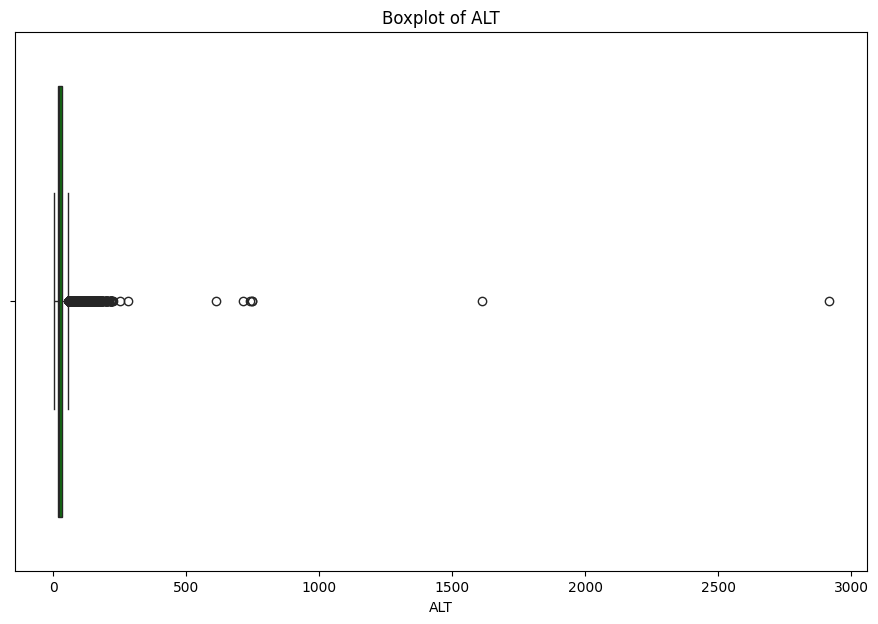

------------------------------------------
Plus 3 standard_deviation value of ALT from mean : 79.80950679271461
Minus 3 standard deviation value of ALT from mean : -26.708914036397744
Positive outliers value in ALT : 56.0
Skewness in ALT : 34.8300119320999


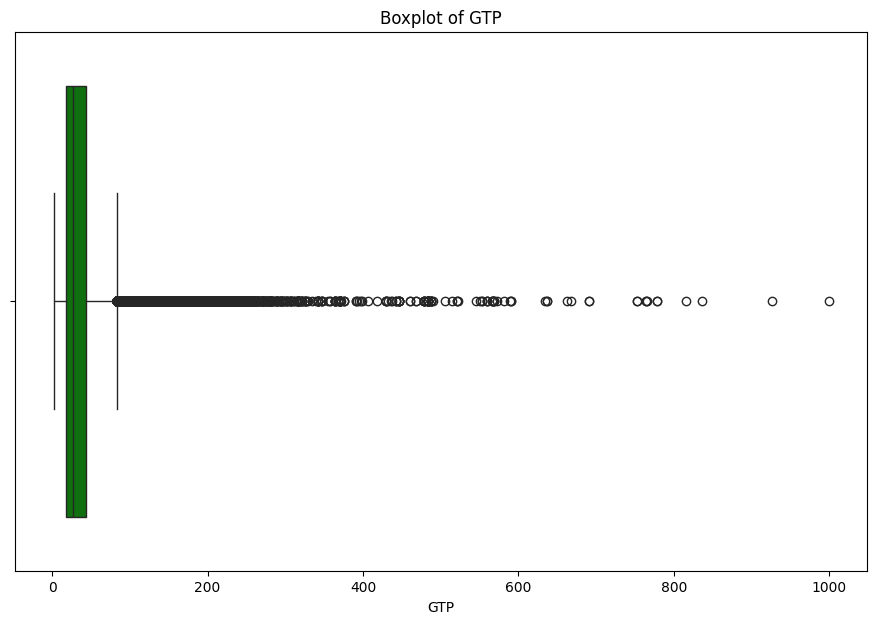

------------------------------------------
Plus 3 standard_deviation value of GTP from mean : 129.8299324989083
Minus 3 standard deviation value of GTP from mean : -57.39792365779714
Positive outliers value in GTP : 83.0
Skewness in GTP : 5.414827255969211


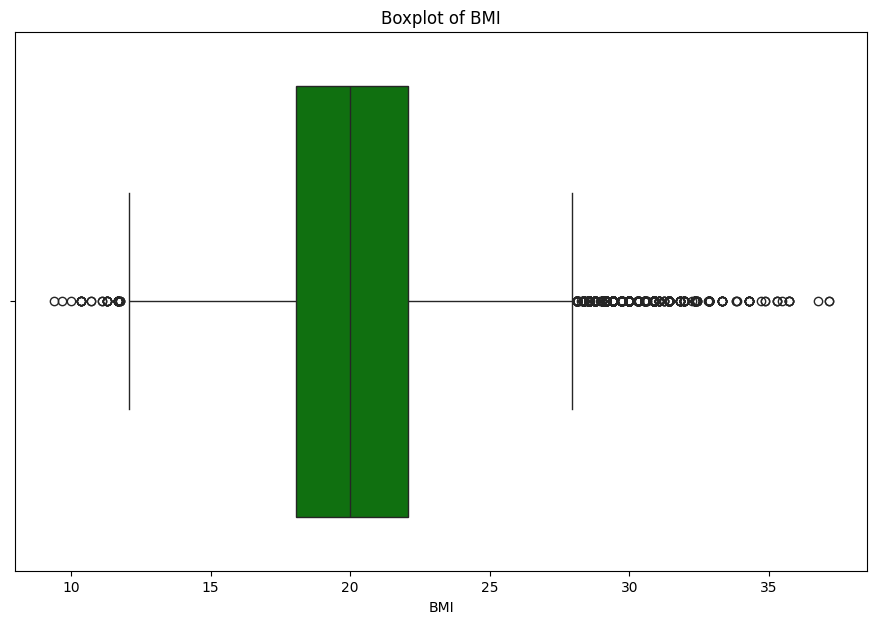

------------------------------------------
Plus 3 standard_deviation value of BMI from mean : 29.687591493286277
Minus 3 standard deviation value of BMI from mean : 10.7746548398627
Positive outliers value in BMI : 28.06372549019608
Skewness in BMI : 0.4020967893557562


In [ ]:
for j in num_smoker.columns : ## Creating the for loop .
  plt.figure(figsize=(11,7))  ## Selecting the size of each plot .
  sns.boxplot(data=num_smoker,x=j,color='green')
  plt.title(f"Boxplot of {j}")
  plt.show()  ## show will show all the visuals .
  print("------------------------------------------")
  print(f"Plus 3 standard_deviation value of {j} from mean :", num_smoker[j].mean()+(num_smoker[j].std()*3))
  print(f"Minus 3 standard deviation value of {j} from mean :", num_smoker[j].mean()-(num_smoker[j].std()*3))
  print(f"Positive outliers value in {j} :", np.percentile(num_smoker[j],75,interpolation='midpoint')+(np.percentile(num_smoker[j],75,interpolation='midpoint')-
        np.percentile(num_smoker[j],25,interpolation='midpoint'))*1.5)
  print(f"Skewness in {j} :", num_smoker[j].skew())

 **Skewness and Outliers :**

'ALT' has the highest amount of skewness of 34.83 followed by 'AST' with 11.59.
Both these columns have extreme values in their higher part or right tail . These two columns has extreme outliers and we need to convert them or drop them .

'Eyesight_l','Eyesight_r','Hearing_l','Hearing_r','sugar_fasting','LDL','Urine_protien','GTP' all these columns are moderately to highly skewed . We need to reduce the skewness to make these columns more useful for Machine learning model .

In [ ]:
## Using filter method to fetch the matching rows . '|' is used when we create a or filter .
eye_issues=smoker[(smoker['Eyesight_l']>=2) | (smoker['Eyesight_r']>=2)]
eye_issues.shape ## shape function will show total no of rows and columns .

(1174, 25)

In [ ]:
eye_issues.head() ## head function will show us the top 5 rows .

,id,Age,Height,Weight,Waist,Eyesight_l,Eyesight_r,Hearing_l,Hearing_r,Systolic_BP,...,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,Dental_caries,Smoker,BMI
20,20,20,175,60,71.5,2.0,1.5,1,1,97,...,77,15.7,1,1.0,18,15,16,0,1,17.142857
105,105,40,160,60,76.0,1.5,2.0,1,1,108,...,123,14.5,1,0.9,24,34,15,0,0,18.750000
213,213,55,170,90,108.5,1.2,9.9,1,1,153,...,77,15.7,1,0.6,31,22,35,0,0,26.470588
235,235,40,165,75,90.0,1.5,2.0,1,1,130,...,162,16.9,1,1.0,27,39,37,0,1,22.727273
413,413,70,155,60,84.0,9.9,1.0,1,1,144,...,160,13.2,1,0.7,20,13,23,0,0,19.354839


In [ ]:
print("Percentage of Smoker and non smoker when there are eye_issues :\n",eye_issues.Smoker.value_counts()*100/(len(eye_issues)))
print("-----------------------")
print("Percentage of Smoker and non smoker in overall dataset : \n", smoker.Smoker.value_counts()*100/len(smoker))

Percentage of Smoker and non smoker when there are eye_issues :
 Smoker
1    50.170358
0    49.829642
Name: count, dtype: float64
-----------------------
Percentage of Smoker and non smoker in overall dataset : 
 Smoker
0    56.2635
1    43.7365
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows .
high_bp=smoker[smoker.Systolic_BP>=140]
high_bp.shape ## shape function will show total no of rows and columns .

(13402, 25)

In [ ]:
print("Percentage of Smoker and non smoker where the BP is more than 140 :\n" , high_bp.Smoker.value_counts()*100/len(high_bp))

Percentage of Smoker and non smoker where the BP is more than 140 :
 Smoker
0    61.826593
1    38.173407
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows .
high_sugar=smoker[smoker.Sugar_fasting>=150]
high_sugar.shape ## shape function will show total no of rows and columns .

(1804, 25)

In [ ]:
print("Percentage of Smoker and non smoker where the sugar fasting is more than 150 :\n", high_sugar.Smoker.value_counts()*100/len(high_sugar))

Percentage of Smoker and non smoker where the sugar fasting is more than 150 :
 Smoker
1    57.594235
0    42.405765
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows . '|' is used when we create a or filter .
LDL_triglyceride=smoker[(smoker['LDL']>=250)|(smoker['Triglyceride']>=275)]
LDL_triglyceride.shape ## shape function will show total no of rows and columns .

(5566, 25)

In [ ]:
print("Percentage of Smoker and non smoker where the LDL and Triglyceride is more than 250 :\n", LDL_triglyceride.Smoker.value_counts()*100/len(LDL_triglyceride))

Percentage of Smoker and non smoker where the LDL and Triglyceride is more than 250 :
 Smoker
1    74.200503
0    25.799497
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows .
Low_hemoglobin=smoker[smoker.Hemoglobin<=10]
Low_hemoglobin.shape ## shape function will show total no of rows and columns .

(793, 25)

In [ ]:
print("Percentage of Smoker and non smoker where the Hemoglobion is less than 10 :\n", Low_hemoglobin.Smoker.value_counts()*100/len(Low_hemoglobin))

Percentage of Smoker and non smoker where the Hemoglobion is less than 10 :
 Smoker
0    97.351828
1     2.648172
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows .
Low_HDL=smoker[smoker.HDL<=35]
Low_HDL.shape ## shape function will show total no of rows and columns .

(4369, 25)

In [ ]:
print("Percentage of Smoker and non smoker where the HDL is less than 35 :\n", Low_HDL.Smoker.value_counts()*100/len(Low_HDL))

Percentage of Smoker and non smoker where the HDL is less than 35 :
 Smoker
1    69.42092
0    30.57908
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows . '&' is used when we create a and filter .
High_gtp_ALT=smoker[(smoker['GTP']>100)&(smoker['ALT']>=60)]
High_gtp_ALT.shape ## shape function will show total no of rows and columns .

(925, 25)

In [ ]:
print("Percentage of Smoker and non smoker where the GTP and ALT is high :\n", High_gtp_ALT.Smoker.value_counts()*100/len(High_gtp_ALT))

Percentage of Smoker and non smoker where the GTP and ALT is high :
 Smoker
1    80.648649
0    19.351351
Name: count, dtype: float64


In [ ]:
## Using filter method to fetch the matching rows .
high_BMI=smoker[smoker.BMI>=28]
high_BMI.shape ## shape function will show total no of rows and columns .

(1980, 25)

In [ ]:
print("Percentage of Smoker and smoker where the BMI is more than 28 :\n" , high_BMI.Smoker.value_counts()*100/len(high_BMI))

Percentage of Smoker and smoker where the BMI is more than 28 :
 Smoker
1    65.30303
0    34.69697
Name: count, dtype: float64


# Data analysis :

1. Smokers has a liitle more tendency of having Eye_issues than normal People .

2. High_BP doesn't mean that the person is a smoker .

3. The percentage of smokers increases to 57.59% when the sugar fasting is more than 150 .

4. People who has higher Triglyceride or high LDL are generally smokers . 74.20% people are Smokers who have higher LDL or Triglyceride .

5. Lower Hemoglobin doesn't mean that a person is a smoker . The percentage of smoker drops to 2.64% when the Hemoglobin is less than 10 .

6. 69.42% people are smokers among all the people who has HDL or Good cholestrol less than 35 .

7. Out of all those person whose GTP is more than 100 and ALT is more than 60 , nearly 80.64% people are smokers .

8. People who smokes has a chance of getting Higher BMI than normal person . Out of all High BMI people 65.30% are smokers .

In [ ]:
skewed_columns ## Just need to see the skewed columns .

['Triglyceride', 'LDL', 'AST', 'ALT', 'GTP']

Creating nan values or null values of all those datapoints which are extremely skewed and mediacally very less probable .

In [ ]:
smoker.ALT[smoker.ALT>=200]=np.nan ## Creating null values of all those datapoints which are excedding a certain pre defined range .

<ipython-input-33-70055979f501>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  smoker.ALT[smoker.ALT>=200]=np.nan


In [ ]:
smoker.GTP[smoker.GTP>=400]=np.nan ## Creating null values of all those datapoints which are excedding a certain pre defined range .

<ipython-input-34-579e3fb96862>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  smoker.GTP[smoker.GTP>=400]=np.nan


In [ ]:
smoker.AST[smoker.AST>=150]=np.nan ## Creating null values of all those datapoints which are excedding a certain pre defined range .

<ipython-input-35-8bcd3c0c8680>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  smoker.AST[smoker.AST>=150]=np.nan


In [ ]:
smoker.LDL[smoker.LDL>=700]=np.nan ## Creating null values of all those datapoints which are excedding a certain pre defined range .

<ipython-input-36-cb348e81c7e1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  smoker.LDL[smoker.LDL>=700]=np.nan


In [ ]:
smoker.head() ## head function will show us the top 5 rows .

,id,Age,Height,Weight,Waist,Eyesight_l,Eyesight_r,Hearing_l,Hearing_r,Systolic_BP,...,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,Dental_caries,Smoker,BMI
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,75.0,16.5,1,1.0,22.0,25.0,27.0,0,1,18.181818
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,126.0,16.2,1,1.1,27.0,23.0,37.0,1,0,19.696970
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,93.0,17.4,1,0.8,27.0,31.0,53.0,0,1,22.058824
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,102.0,15.9,1,1.0,20.0,27.0,30.0,1,0,26.388889
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,93.0,15.4,1,0.8,19.0,13.0,17.0,0,1,18.181818


In [ ]:
smoker.isnull().sum() ## isnull().sum() will show us the total no of null values in each column .

id                    0
Age                   0
Height                0
Weight                0
Waist                 0
Eyesight_l            0
Eyesight_r            0
Hearing_l             0
Hearing_r             0
Systolic_BP           0
Relaxation            0
Sugar_fasting         0
Total_cholesterol     0
Triglyceride          0
HDL                   0
LDL                  14
Hemoglobin            0
Urine_protein         0
Creatinine            0
AST                  18
ALT                  26
GTP                  89
Dental_caries         0
Smoker                0
BMI                   0
dtype: int64

In [ ]:
new_smoker=smoker.dropna() ## Dropna function will drop all the null values .

In [ ]:
new_smoker.isnull().sum() ## isnull().sum() will show us the total no of null values in each column .

id                   0
Age                  0
Height               0
Weight               0
Waist                0
Eyesight_l           0
Eyesight_r           0
Hearing_l            0
Hearing_r            0
Systolic_BP          0
Relaxation           0
Sugar_fasting        0
Total_cholesterol    0
Triglyceride         0
HDL                  0
LDL                  0
Hemoglobin           0
Urine_protein        0
Creatinine           0
AST                  0
ALT                  0
GTP                  0
Dental_caries        0
Smoker               0
BMI                  0
dtype: int64

In [ ]:
## Creating a scatterplot to see if there is any positive relationship between two indipendent columns .
fig=px.scatter(new_smoker,x='LDL',y='Triglyceride',width=650,height=650,trendline="ols",
               title="Scatterplot to see the relation between LDL and Triglyceride")
fig.show()

LDL and Triglyceride does not Posseses any kind of relation .

In [ ]:
## Creating a scatterplot to see if there is any positive relationship between two indipendent columns .
fig=px.scatter(new_smoker,x='BMI',y='Hemoglobin',width=700,height=700,
               trendline='ols',title="Scatterplot to see the relationship between BMI and Hemoglobin")
fig.show()

BMI and Hemoglobin has a slight positive relation .

In [ ]:
## Creating a scatterplot to see if there is any positive relationship between two indipendent columns .
fig=px.scatter(new_smoker,y='HDL',x='Weight',width=700,height=700,
               trendline='ols',title="Scatterplot to see the relationship between Weight and HDL")
fig.show()

Weight and HDL has a negative relationship . It means when the weight increases the HDL decreases .

In [ ]:
## Creating a scatterplot to see if there is any positive relationship between two indipendent columns .
fig=px.scatter(new_smoker,x='Sugar_fasting',y='Systolic_BP',width=700,height=700,
               trendline='ols',title="Scatterplot to see the relationship between Sugar_fasting and BP")
fig.show()

Sugar_fasting and BP has a very light positive relation .

In [ ]:
new_smoker.head() ## head function will show us the top 5 rows .

,id,Age,Height,Weight,Waist,Eyesight_l,Eyesight_r,Hearing_l,Hearing_r,Systolic_BP,...,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,Dental_caries,Smoker,BMI
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,75.0,16.5,1,1.0,22.0,25.0,27.0,0,1,18.181818
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,126.0,16.2,1,1.1,27.0,23.0,37.0,1,0,19.696970
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,93.0,17.4,1,0.8,27.0,31.0,53.0,0,1,22.058824
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,102.0,15.9,1,1.0,20.0,27.0,30.0,1,0,26.388889
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,93.0,15.4,1,0.8,19.0,13.0,17.0,0,1,18.181818


In [ ]:
new_smoker=new_smoker.drop(['id'],axis=1) ## Dropping some unnecessary columns with drop function .

In [ ]:
## Creating a barplot to see the count of each distinct values .
Dental=new_smoker.Dental_caries.value_counts()
fig=px.bar(Dental,y='count',width=600,height=600,
           title="Total count of Dental_caries")
fig.show()
print("Percentage of Dental caries in overall dataset :", (new_smoker.Dental_caries.value_counts()*100)/len(new_smoker))

Percentage of Dental caries in overall dataset : Dental_caries
0    80.205001
1    19.794999
Name: count, dtype: float64


Only 19.80% people has dental_caries .

In [ ]:
Smokers=new_smoker[new_smoker.Smoker==1] ## Creating a new dataframe for only smokers .
Smokers.shape ## shape function will show total no of rows and columns .

(69568, 24)

In [ ]:
## Creating a barplot to see the count of each distinct values .
Smoker_dental=Smokers.Dental_caries.value_counts()
fig=px.bar(Smoker_dental,y='count',width=650,height=650,title='Count of Dental caries when the dataset is only containing smokers')
fig.show()
print("Percentage of Dental_caries in Smokers :", (Smokers.Dental_caries.value_counts()*100)/len(Smokers))

Percentage of Dental_caries in Smokers : Dental_caries
0    75.390984
1    24.609016
Name: count, dtype: float64


Smokers has 5% more chances of having Dental_caries than normal person .

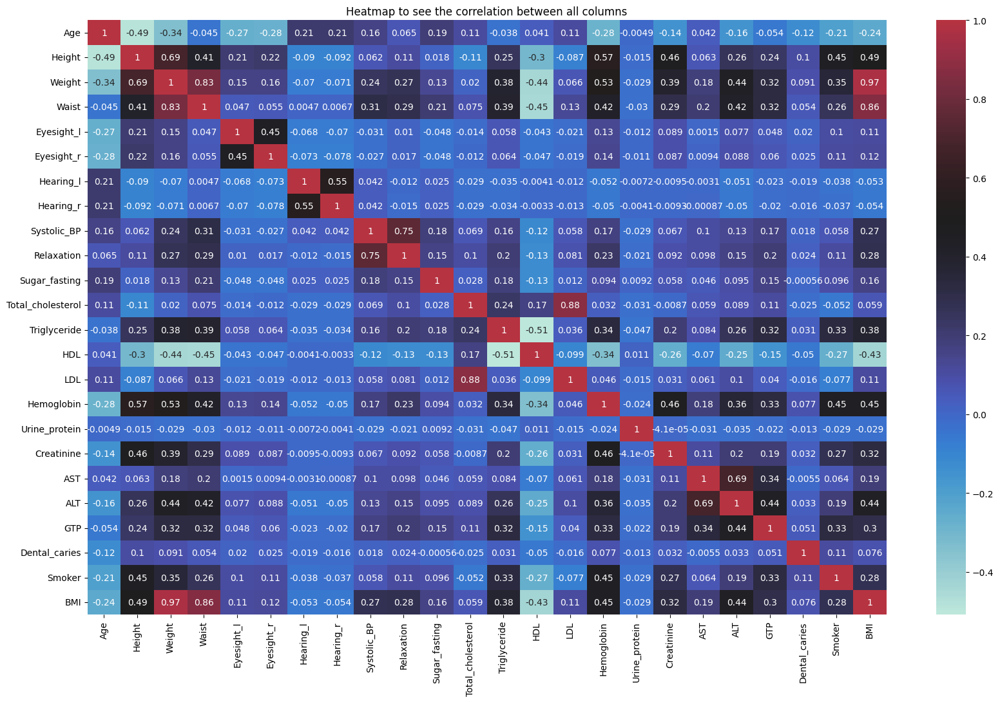

In [ ]:
## Creating heatmap to see the correlation between our target variable and all indipendent columns .
smoker_corr=new_smoker.corr() ## Creating a correlation between all numeric columns .
plt.figure(figsize=(20,12))
sns.heatmap(data=smoker_corr,annot=True,center=0.5) ## heatmap will visually show the correlation value between all the columns .
plt.title("Heatmap to see the correlation between all columns")
plt.show()

In [ ]:
X=new_smoker.drop(['Smoker'],axis=1)  ## Creating X dataset for all the indipendent columns.

In [ ]:
y=new_smoker['Smoker'] ## y is our target variable .

In [ ]:
print(X.shape) ## shape function will show total no of rows and columns .
print(y.shape) ## shape function will show total no of rows and columns .

(159121, 23)
(159121,)


 statsmodels.api shows us the p_value of each indipendent column .

 p_value shows whether the column is significant or not . If the p_value is less than 0.05 then the column is significant otherwise it is not that significant .

In [ ]:
import statsmodels.api as sm ## Importing statsmodels.api library .
model=sm.Logit(y,X)
result=model.fit()
print(result.summary())

Optimization terminated successfully.
         Current function value: 0.494151
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                 Smoker   No. Observations:               159121
Model:                          Logit   Df Residuals:                   159098
Method:                           MLE   Df Model:                           22
Date:                Sun, 05 May 2024   Pseudo R-squ.:                  0.2789
Time:                        02:59:04   Log-Likelihood:                -78630.
converged:                       True   LL-Null:                   -1.0904e+05
Covariance Type:            nonrobust   LLR p-value:                     0.000
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
Age                  -0.0027      0.001     -3.866      0.000      -0.004      -0.001
Height  

Eyesight_l,Hearing_l,Hearing_r and Total cholesterol has p_value of more than 0.05 . That suggests that these columns are not that significant for our ML model .

In [ ]:
new_smoker=new_smoker.drop(['Eyesight_l','Hearing_l','Hearing_r','Total_cholesterol'],axis=1) ## Dropping some unnecessary columns with drop function .
new_smoker.head() ## head function will show us the top 5 rows .

,Age,Height,Weight,Waist,Eyesight_r,Systolic_BP,Relaxation,Sugar_fasting,Triglyceride,HDL,LDL,Hemoglobin,Urine_protein,Creatinine,AST,ALT,GTP,Dental_caries,Smoker,BMI
0,55,165,60,81.0,0.6,135,87,94,300,40,75.0,16.5,1,1.0,22.0,25.0,27.0,0,1,18.181818
1,70,165,65,89.0,0.7,146,83,147,55,57,126.0,16.2,1,1.1,27.0,23.0,37.0,1,0,19.696970
2,20,170,75,81.0,0.5,118,75,79,197,45,93.0,17.4,1,0.8,27.0,31.0,53.0,0,1,22.058824
3,35,180,95,105.0,1.2,131,88,91,203,38,102.0,15.9,1,1.0,20.0,27.0,30.0,1,0,26.388889
4,30,165,60,80.5,1.0,121,76,91,87,44,93.0,15.4,1,0.8,19.0,13.0,17.0,0,1,18.181818


In [ ]:
X=new_smoker.drop(['Smoker'],axis=1) ## Creating X dataset for all the indipendent columns.

In [ ]:
y=new_smoker['Smoker']  ## y is our target variable .

In [ ]:
## train_test_split will split the dataset into training and testing .
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=11) ## test_size=0.3 means 30% of datapoints will be kept for testing and others will be used for training .

In [ ]:
print(y_train.shape) ## shape function will show total no of rows and columns .
print(X_test.shape) ## shape function will show total no of rows and columns .

(111384,)
(47737, 19)


In [ ]:
from sklearn.preprocessing import StandardScaler ## Importing Standardscaler to reduce the skewness in dataset .

In [ ]:
SC=StandardScaler()
SC_Xtrain=SC.fit_transform(X_train) ## Fitting the X train data with Standardscaler .

In [ ]:
SC_Xtest=SC.transform(X_test) ## Only transforming the X_test data with Standardscaler .

In this project i have used 7 different ML algorithms to correctly predict Smoker and non_smoker . I have also tuned some of the algorithms to make it more robust and accurate.

Below i have mentioned all the algorithms and where i have used Hyperparameter tuning.

# ML algorithms :

1. Logistic Regression

2. DecisionTreeClassifier (Hyperparameter tuning)

3. RandomForestClassifier (Hyperparameter tuning)

4. KNearestNeighbors

5. xgboost (Hyperparameter tuning)

6. svm or support vector machine

7. Naive bayes or GaussianNB

In the end i have compared all the algorithms and commented on which will be best for which purpose .

**Evaluation metrics in classification model :**

1. accuracy_score : accuracy score is basically the ratio between Total_no_of_correct_predictions/Total no of datapoints .

2. confusion_matrix : confusion matrix not only shows total no of correct or wrong prediction but it also shows the number of True Positive , False Positive , True Negative and False Negative .

3. f1_score : This is a metric which is a harmonic mean between precision and recall.

4. classification report : classification_report shows avg_accuracy , avg f1_score , precision and recall score .[link text](https://)

In [ ]:
from sklearn.metrics import accuracy_score,f1_score,classification_report,roc_auc_score,confusion_matrix ## Importing all the metrics from sklearn library .

In [ ]:
from sklearn.linear_model import LogisticRegression
LR=LogisticRegression(max_iter=500)
LR.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
LR_pred=LR.predict(SC_Xtest) ## Predicting the model with X_test dataset .
LR_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score of Logistic Regression algorithm :", accuracy_score(LR_pred,y_test))
print("roc_auc score of Logistic Regression algorithm :", roc_auc_score(y_test,LR_pred))
print("f1_score of Logistic Regression algorithm :", f1_score(y_test,LR_pred))

Accuracy score of Logistic Regression algorithm : 0.7533569348723212
roc_auc score of Logistic Regression algorithm : 0.7527950240551076
f1_score of Logistic Regression algorithm : 0.7254453875571308


In [ ]:
print(confusion_matrix(LR_pred,y_test))

[[20408  5228]
 [ 6546 15555]]


In [ ]:
print(classification_report(y_test,LR_pred))

              precision    recall  f1-score   support

           0       0.80      0.76      0.78     26954
           1       0.70      0.75      0.73     20783

    accuracy                           0.75     47737
   macro avg       0.75      0.75      0.75     47737
weighted avg       0.76      0.75      0.75     47737



In [ ]:
from sklearn.tree import DecisionTreeClassifier
DC=DecisionTreeClassifier()
DC.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
DC_pred=DC.predict(SC_Xtest) ## Predicting the model with X_test dataset .
DC_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score of DecisionTree algorithm :", accuracy_score(DC_pred,y_test))
print("roc_auc score of DecisionTree algorithm :", roc_auc_score(y_test,DC_pred))
print("f1_score of DecisionTree algorithm :", f1_score(y_test,DC_pred))

Accuracy score of DecisionTree algorithm : 0.692397930326581
roc_auc score of DecisionTree algorithm : 0.6870986475321111
f1_score of DecisionTree algorithm : 0.6465093885411651


In [ ]:
print(confusion_matrix(y_test,DC_pred))

[[19625  7329]
 [ 7355 13428]]


In [ ]:
print(classification_report(y_test,DC_pred))

              precision    recall  f1-score   support

           0       0.73      0.73      0.73     26954
           1       0.65      0.65      0.65     20783

    accuracy                           0.69     47737
   macro avg       0.69      0.69      0.69     47737
weighted avg       0.69      0.69      0.69     47737



In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
## Creating a pool of parameters from where we will get the best parameters for our algorithm .
DC_params={'max_depth':[7,11,15,19],'min_samples_leaf':[6,10,14,18],
           'min_samples_split':[8,12,16,20]}
DC_grid=GridSearchCV(estimator=DC,param_grid=DC_params,scoring='accuracy',refit=True,verbose=1)
DC_grid.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
DC_grid.best_params_ ## best_params_ will show us the best_parameters .

Fitting 5 folds for each of 64 candidates, totalling 320 fits


{'max_depth': 7, 'min_samples_leaf': 18, 'min_samples_split': 8}

In [ ]:
New_DC=DecisionTreeClassifier(max_depth=7,min_samples_leaf=18,min_samples_split=8,criterion='entropy')
New_DC.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
New_DC_pred=New_DC.predict(SC_Xtest) ## Predicting the model with X_test dataset .
New_DC_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score of DecisionTree algorithm after hyperparameter tuning :", accuracy_score(New_DC_pred,y_test))
print("roc_auc score of DecisionTree algorithm hyperparameter tuning  :", roc_auc_score(y_test,New_DC_pred))
print("f1_score of DecisionTree algorithm hyperparameter tuning  :", f1_score(y_test,New_DC_pred))

Accuracy score of DecisionTree algorithm after hyperparameter tuning : 0.7568343213859271
roc_auc score of DecisionTree algorithm hyperparameter tuning  : 0.7645549555271727
f1_score of DecisionTree algorithm hyperparameter tuning  : 0.7469369958578592


In [ ]:
print(confusion_matrix(y_test,New_DC_pred))

[[18998  7956]
 [ 3652 17131]]


In [ ]:
print(classification_report(New_DC_pred,y_test))

              precision    recall  f1-score   support

           0       0.70      0.84      0.77     22650
           1       0.82      0.68      0.75     25087

    accuracy                           0.76     47737
   macro avg       0.76      0.76      0.76     47737
weighted avg       0.77      0.76      0.76     47737



In [ ]:
from sklearn.ensemble import RandomForestClassifier
RF=RandomForestClassifier()
RF.fit(SC_Xtrain,y_train) ## Fitting the model into X,y training dataset .
RF_pred=RF.predict(SC_Xtest) ## Predicting the model with X_test dataset .
RF_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score of RandomForestClassifier algorithm :", accuracy_score(RF_pred,y_test))
print("roc_auc score of RandomForestClassifier algorithm :", roc_auc_score(y_test,RF_pred))
print("f1_score of RandomForestClassifier algorithm :", f1_score(y_test,RF_pred))

Accuracy score of RandomForestClassifier algorithm : 0.7753734000879821
roc_auc score of RandomForestClassifier algorithm : 0.7787631050773154
f1_score of RandomForestClassifier algorithm : 0.7573048457551547


In [ ]:
print(confusion_matrix(RF_pred,y_test))

[[20284  4053]
 [ 6670 16730]]


In [ ]:
print(classification_report(y_test,RF_pred))

              precision    recall  f1-score   support

           0       0.83      0.75      0.79     26954
           1       0.71      0.80      0.76     20783

    accuracy                           0.78     47737
   macro avg       0.77      0.78      0.77     47737
weighted avg       0.78      0.78      0.78     47737



In [ ]:
## Creating a pool of parameters from where we will get the best parameters for our algorithm .
RF_params={'n_estimators':[8,11,15,20,25,30],'criterion':['entropy','gini']}
RF_grid=GridSearchCV(estimator=RF,param_grid=RF_params,scoring='accuracy',refit=True,verbose=1)
RF_grid.fit(SC_Xtrain,y_train) ## Fitting the model into X,y training dataset .
RF_grid.best_params_ ## best_params_ will show us the best_parameters .

Fitting 5 folds for each of 12 candidates, totalling 60 fits


{'criterion': 'entropy', 'n_estimators': 30}

In [ ]:
New_RF=RandomForestClassifier(n_estimators=30,max_depth=7,criterion='entropy')
New_RF.fit(SC_Xtrain,y_train) ## Fitting the model into X,y training dataset .
New_RF_pred=New_RF.predict(SC_Xtest) ## Predicting the model with X_test dataset .
New_RF_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score of RandomForestClassifier algorithm after hyperparameter tuning :", accuracy_score(New_RF_pred,y_test))
print("roc_auc score of RandomForestClassifier algorithm after hyperparameter tuning :", roc_auc_score(y_test,New_RF_pred))
print("f1_score of RandomForestClassifier algorithm after hyperparameter tuning :", f1_score(y_test,New_RF_pred))

Accuracy score of RandomForestClassifier algorithm after hyperparameter tuning : 0.7611915285836982
roc_auc score of RandomForestClassifier algorithm after hyperparameter tuning : 0.7696196334303014
f1_score of RandomForestClassifier algorithm after hyperparameter tuning : 0.7527114967462039


In [ ]:
print(confusion_matrix(New_RF_pred,y_test))

[[18987  3433]
 [ 7967 17350]]


In [ ]:
print(classification_report(y_test,New_RF_pred))

              precision    recall  f1-score   support

           0       0.85      0.70      0.77     26954
           1       0.69      0.83      0.75     20783

    accuracy                           0.76     47737
   macro avg       0.77      0.77      0.76     47737
weighted avg       0.78      0.76      0.76     47737



In [ ]:
from sklearn.neighbors import KNeighborsClassifier
KNN=KNeighborsClassifier(n_neighbors=5) ## n_neighbors is the most important parameter for KNN algorithm .
KNN.fit(SC_Xtrain,y_train) ## Fitting the model into X,y training dataset .
KNN_pred=KNN.predict(SC_Xtest)  ## Predicting the model with X_test dataset .
KNN_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score of KneighborsClassifier algorithm :", accuracy_score(KNN_pred,y_test))
print("roc_auc score of KneighborsClassifier algorithm :", roc_auc_score(y_test,KNN_pred))
print("f1_score of KneighborsClassifier algorithm :", f1_score(y_test,KNN_pred))

Accuracy score of KneighborsClassifier algorithm : 0.7342103609359616
roc_auc score of KneighborsClassifier algorithm : 0.7338132674181544
f1_score of KneighborsClassifier algorithm : 0.7053550694347684


In [ ]:
print(confusion_matrix(KNN_pred,y_test))

[[19862  5596]
 [ 7092 15187]]


In [ ]:
print(classification_report(KNN_pred,y_test))

              precision    recall  f1-score   support

           0       0.74      0.78      0.76     25458
           1       0.73      0.68      0.71     22279

    accuracy                           0.73     47737
   macro avg       0.73      0.73      0.73     47737
weighted avg       0.73      0.73      0.73     47737



In [ ]:
import xgboost as xgb
xgb_class=xgb.XGBClassifier()
xgb_class.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
xgb_pred=xgb_class.predict(SC_Xtest)  ## Predicting the model with X_test dataset .
xgb_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score for xgboostclassifier algorithm :" ,accuracy_score(y_test,xgb_pred))
print("roc_auc score for xgboostclassifier algorithm :" ,roc_auc_score(y_test,xgb_pred))
print("f1 score for xgboostclassifier algorithm :" ,f1_score(y_test,xgb_pred))

Accuracy score for xgboostclassifier algorithm : 0.7798562959549197
roc_auc score for xgboostclassifier algorithm : 0.7832726154732936
f1 score for xgboostclassifier algorithm : 0.7620513981659685


In [ ]:
print(confusion_matrix(y_test,xgb_pred))

[[20400  6554]
 [ 3955 16828]]


In [ ]:
print(classification_report(y_test,xgb_pred))

              precision    recall  f1-score   support

           0       0.84      0.76      0.80     26954
           1       0.72      0.81      0.76     20783

    accuracy                           0.78     47737
   macro avg       0.78      0.78      0.78     47737
weighted avg       0.79      0.78      0.78     47737



In [ ]:
## Creating a pool of parameters from where we will get the best parameters for our algorithm .
xgb_params={'learning_rate':[0.1,0.01,1],'gamma':[0.1,0.01,1],
            'max_depth':[5,8,11,15]}
xgb_grid=GridSearchCV(estimator=xgb_class,param_grid=xgb_params,scoring='accuracy',refit=True,verbose=1)
xgb_grid.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
xgb_grid.best_params_  ## best_params_ will show us the best_parameters .

Fitting 5 folds for each of 36 candidates, totalling 180 fits


{'gamma': 1, 'learning_rate': 0.1, 'max_depth': 5}

In [ ]:
new_xgb=xgb.XGBClassifier(n_estimators=30,max_depth=5,learning_rate=0.1,gamma=1)
new_xgb.fit(SC_Xtrain,y_train) ## Fitting the model into X,y training dataset .
new_xgb_pred=new_xgb.predict(SC_Xtest)  ## Predicting the model with X_test dataset .
new_xgb_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score for xgboostclassifier algorithm after hyperparameter tuning :" ,accuracy_score(y_test,new_xgb_pred))
print("roc_auc score for xgboostclassifier algorithm after hyperparameter tuning :" ,roc_auc_score(y_test,new_xgb_pred))
print("f1 score for xgboostclassifier algorithm after hyperparameter tuning :" ,f1_score(y_test,new_xgb_pred))

Accuracy score for xgboostclassifier algorithm after hyperparameter tuning : 0.771183777782433
roc_auc score for xgboostclassifier algorithm after hyperparameter tuning : 0.7786002338777445
f1 score for xgboostclassifier algorithm after hyperparameter tuning : 0.7608329136651266


In [ ]:
print(confusion_matrix(y_test,new_xgb_pred))

[[19440  7514]
 [ 3409 17374]]


In [ ]:
print(classification_report(y_test,new_xgb_pred))

              precision    recall  f1-score   support

           0       0.85      0.72      0.78     26954
           1       0.70      0.84      0.76     20783

    accuracy                           0.77     47737
   macro avg       0.77      0.78      0.77     47737
weighted avg       0.78      0.77      0.77     47737



In [ ]:
from sklearn.naive_bayes import GaussianNB
GNB=GaussianNB()
GNB.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
GNB_pred=GNB.predict(SC_Xtest)  ## Predicting the model with X_test dataset .
GNB_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score for NaiveBayes or GaussianNB algorithm :" ,accuracy_score(y_test,GNB_pred))
print("roc_auc score for NaiveBayes or GaussianNB algorithm :" ,roc_auc_score(y_test,GNB_pred))
print("f1 score for NaiveBayes or GaussianNB algorithm :" ,f1_score(y_test,GNB_pred))

Accuracy score for NaiveBayes or GaussianNB algorithm : 0.7213482204579257
roc_auc score for NaiveBayes or GaussianNB algorithm : 0.7253647653124695
f1 score for NaiveBayes or GaussianNB algorithm : 0.7027087430716967


In [ ]:
print(confusion_matrix(y_test,GNB_pred))

[[18714  8240]
 [ 5062 15721]]


In [ ]:
print(classification_report(y_test,GNB_pred))

              precision    recall  f1-score   support

           0       0.79      0.69      0.74     26954
           1       0.66      0.76      0.70     20783

    accuracy                           0.72     47737
   macro avg       0.72      0.73      0.72     47737
weighted avg       0.73      0.72      0.72     47737



In [ ]:
from sklearn import svm
SVM=svm.SVC(C=0.1,kernel='rbf',gamma=0.1) ## C and gamma are parameters and kernel is the most important parameter in svm .
SVM.fit(SC_Xtrain,y_train)  ## Fitting the model into X,y training dataset .
SVM_pred=SVM.predict(SC_Xtest)  ## Predicting the model with X_test dataset .
SVM_pred

array([0, 0, 1, ..., 1, 1, 1])

In [ ]:
print("Accuracy score for svm algorithm :", accuracy_score(y_test,SVM_pred))
print("Accuracy score for svm algorithm :", roc_auc_score(y_test,SVM_pred))
print("Accuracy score for svm algorithm :", f1_score(y_test,SVM_pred))

Accuracy score for svm algorithm : 0.7715398956784046
Accuracy score for svm algorithm : 0.779912534320672
Accuracy score for svm algorithm : 0.7629954798331015


In [ ]:
print(confusion_matrix(y_test,SVM_pred))

[[19276  7678]
 [ 3228 17555]]


In [ ]:
print(classification_report(y_test,SVM_pred))

              precision    recall  f1-score   support

           0       0.86      0.72      0.78     26954
           1       0.70      0.84      0.76     20783

    accuracy                           0.77     47737
   macro avg       0.78      0.78      0.77     47737
weighted avg       0.79      0.77      0.77     47737



**Accuracy_score comparison :**

1. Accuracy score of Logistic Regression algorithm : 75.33

2. Accuracy score of DecisionTree algorithm : 69.23

3. Accuracy score of DecisionTree algorithm after hyperparameter tuning : 75.68

4. Accuracy score of RandomForestClassifier algorithm : 77.53

5. Accuracy score of RandomForestClassifier algorithm after hyperparameter tuning : 76.11

6. Accuracy score of KneighborsClassifier algorithm : 73.42

7. Accuracy score for xgboostclassifier algorithm : 77.98

8. Accuracy score for xgboostclassifier algorithm after hyperparameter tuning : 77.11

9. Accuracy score for NaiveBayes or GaussianNB algorithm : 72.13

10. Accuracy score for svm algorithm : 77.15


**Overall best model :**

If our Project's goal is to find the best model which predicts both smoker and non-smoker precisely then xgboost is the best algorithm .
It achieves an accuracy score of 77.98% with a recall score of 81% for 1 and 76% for 0 .

This means that xgboost has achieved 81% accuracy when it predicts the smoker and 76% accuracy on predicting non-smokers . This is the most balanced model which is capable of predicting Both .

**Predicting Smokers** **:**

If our end goal focuses on predicting the smokers then svm or support vector machine algorithm giving us the highest amount of accuracy .

it has a recall score of 84.46% in predicting Smokers . Out of 20783 datapoints labelled as smokers , our algorithm has correctly predicted 17555 and misclassified only 3228 .

**Predicting Non-smokers :**

If our target is to predict the highest number of Non-smokers then DecisionTreeClassifier algorithm after hyperparameter tuning giving us the highest accuracy .

This algorithm achieves a recall score of 84% in predicting non-smokers . Out of 22650 datapoints labelled as non-smokers it has correctly classifies 18998 and misclassifies only 3652 .